In [1]:
import scipy.io
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scanpy as sc
import seaborn as sns
import glob
import os
import scvi
import anndata as ad

In [2]:
adatas = []
adatas = [sc.read(f) for f in glob.glob(os.path.join(r"GSE188545_RAW/clean_data", "*_quality_control.h5"))]
adata = ad.concat(adatas, label="sample")
adata.obs_names_make_unique()

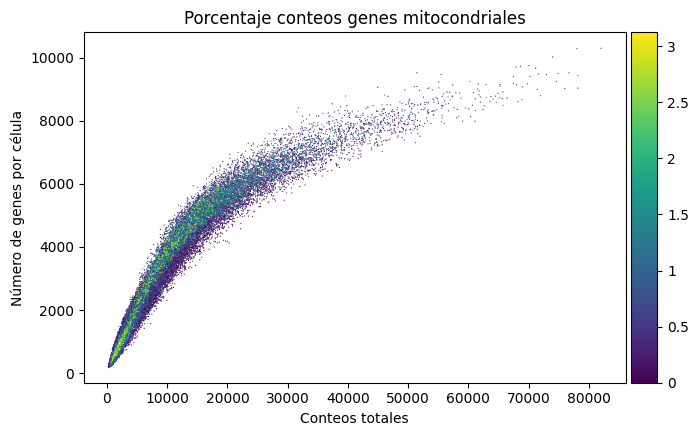

In [31]:
ax = sc.pl.scatter(
    adata,
    "total_counts",
    "n_genes_by_counts",
    color="pct_counts_mt",
    title="Porcentaje conteos genes mitocondriales",
    show=False
)

ax.set_xlabel("Conteos totales")
ax.set_ylabel("Número de genes por célula")

plt.show()

In [197]:
total = 0
doublets_removed = 0
for adata in adatas:
    print(len(adata), adata.uns['doublets_removed'])
    total += len(adata)
    doublets_removed += adata.uns['doublets_removed']

print(total)
print(doublets_removed)
print(doublets_removed*100/total)

423 0.0
2370 83.0
3663 169.0
3250 101.0
2333 90.0
5236 200.0
2744 101.0
7021 474.0
2932 143.0
6676 409.0
573 1.0
3589 88.0
40810
1859.0
4.555256064690027


In [3]:
sc.pp.filter_genes(adata, min_cells = 50)

In [4]:
adata.raw = adata
sc.pp.highly_variable_genes(
    adata,
    n_top_genes=3000, 
    subset=True,
    batch_key='Patient',
    flavor='seurat_v3',
    span=0.5
)

In [ ]:
from sklearn.metrics import silhouette_score
import gc

scvi.model.SCVI.setup_anndata(
    adata, 
    categorical_covariate_keys=['Patient'], 
    continuous_covariate_keys=['pct_counts_mt', 'pct_counts_ribo']
)

sc.tl.pca(adata)
idx_sub = np.random.choice(adata.n_obs, size=min(10000, adata.n_obs), replace=False)
X_pca_sub = adata.obsm['X_pca'][idx_sub]
batch_labels_sub = adata.obs['Patient'].iloc[idx_sub]

sil_before = silhouette_score(X_pca_sub, batch_labels_sub)

param_grid = [
    {'n_layers': 2, 'n_latent': 10, 'gene_likelihood': 'nb', 'dropout_rate': 0.1},
    {'n_layers': 2, 'n_latent': 50, 'gene_likelihood': 'nb', 'dropout_rate': 0.1},
    {'n_layers': 2, 'n_latent': 30, 'gene_likelihood': 'zinb', 'dropout_rate': 0.1},
    {'n_layers': 3, 'n_latent': 50, 'gene_likelihood': 'zinb', 'dropout_rate': 0.1},
    {'n_layers': 2, 'n_latent': 30, 'gene_likelihood': 'poisson', 'dropout_rate': 0.1},
]

results = []

for i, params in enumerate(param_grid):
    print(f"\n--- Entrenando Modelo {i+1}/10 ---")
    print(params)
    
    model = scvi.model.SCVI(
        adata, 
        n_layers=params['n_layers'],
        n_latent=params['n_latent'],
        gene_likelihood=params['gene_likelihood'],
        dropout_rate=params['dropout_rate']
    )
    
    model.train(max_epochs=150, early_stopping=True, early_stopping_patience=5)
    
    latent_key = f'X_scvi_model_{i+1}'
    adata.obsm[latent_key] = model.get_latent_representation()
    
    elbo = model.history['elbo_train'].iloc[-1].item()
    
    X_scvi_sub = adata.obsm[latent_key][idx_sub]
    sil_batch = silhouette_score(X_scvi_sub, batch_labels_sub)
    
    res = params.copy()
    res['Model_ID'] = i+1
    res['ELBO_Loss'] = elbo
    res['Silhouette_Batch'] = sil_batch
    results.append(res)
    
    del model
    gc.collect()

results_df = pd.DataFrame(results)

results_df['Improvement_vs_Baseline'] = sil_before - results_df['Silhouette_Batch']
results_df = results_df.sort_values(by='Silhouette_Batch', ascending=True)

best_model_idx = results_df.iloc[0]['Model_ID']
adata.obsm['X_scvi'] = adata.obsm[f'X_scvi_model_{best_model_idx}']

In [6]:
results_df

,n_layers,n_latent,gene_likelihood,dropout_rate,Model_ID,ELBO_Loss,Silhouette_Batch,Improvement_vs_Baseline
0,2,10,nb,0.1,1,1423.874390,-0.132282,-0.215085
4,2,30,poisson,0.1,5,1553.646851,-0.092296,-0.255071
1,2,50,nb,0.1,2,1433.029907,-0.089915,-0.257452
3,3,50,zinb,0.1,4,1393.878174,-0.082913,-0.264454
2,2,30,zinb,0.1,3,1400.755737,-0.081082,-0.266285


In [ ]:
model = scvi.model.SCVI(adata, n_layers=3, n_latent=50, gene_likelihood="zinb", dropout_rate=0.1)
model.train(max_epochs= 150, early_stopping=True, early_stopping_patience=5)


In [8]:
model.save(r"GSE188545_RAW/clean_data/MTG_Integration_global_model/model.pt")

In [5]:
model = scvi.model.SCVI.load(r"GSE188545_RAW\clean_data\MTG_Integration_global_model\model.pt", adata = adata)

INFO     File GSE188545_RAW\clean_data\MTG_Integration_global_model\model.pt\model.pt already downloaded           


In [6]:
y = model.history['reconstruction_loss_validation']['reconstruction_loss_validation'].min()

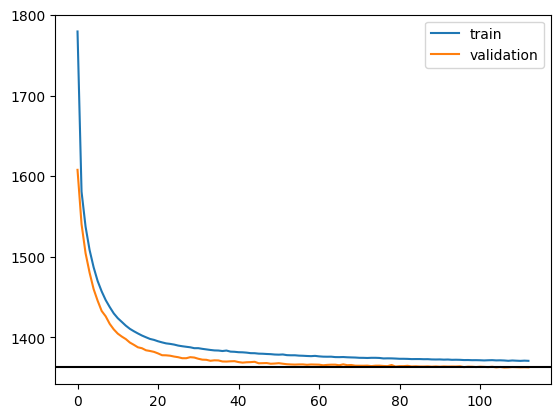

In [7]:
plt.plot(model.history['reconstruction_loss_train']['reconstruction_loss_train'], label = 'train')
plt.plot(model.history['reconstruction_loss_validation']['reconstruction_loss_validation'], label = 'validation')
plt.axhline(y, c = 'k')

plt.legend()
plt.show()

# Annotation Global

In [6]:
adata.obsm['X_scVI'] = model.get_latent_representation()

In [7]:
sc.pp.neighbors(adata, use_rep = 'X_scVI')

In [8]:
sc.tl.leiden(adata, resolution = 0.5, key_added = 'overcluster')

C:\Users\User\AppData\Local\Temp\ipykernel_20900\1756617564.py:1: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution = 0.5, key_added = 'overcluster')


In [9]:
adata.layers['counts'] = adata.X.copy()

In [10]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

In [11]:
sc.tl.umap(adata)

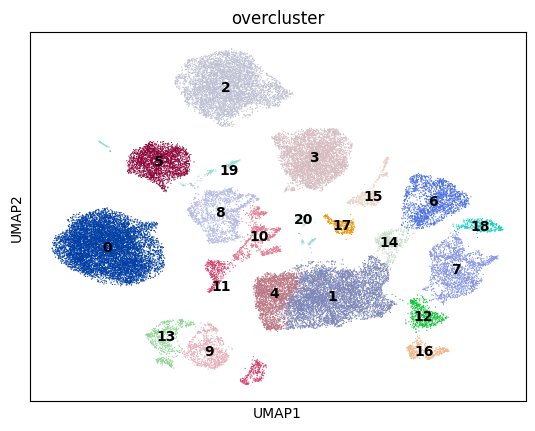

In [12]:
sc.pl.umap(adata, color=["overcluster"], legend_loc="on data")

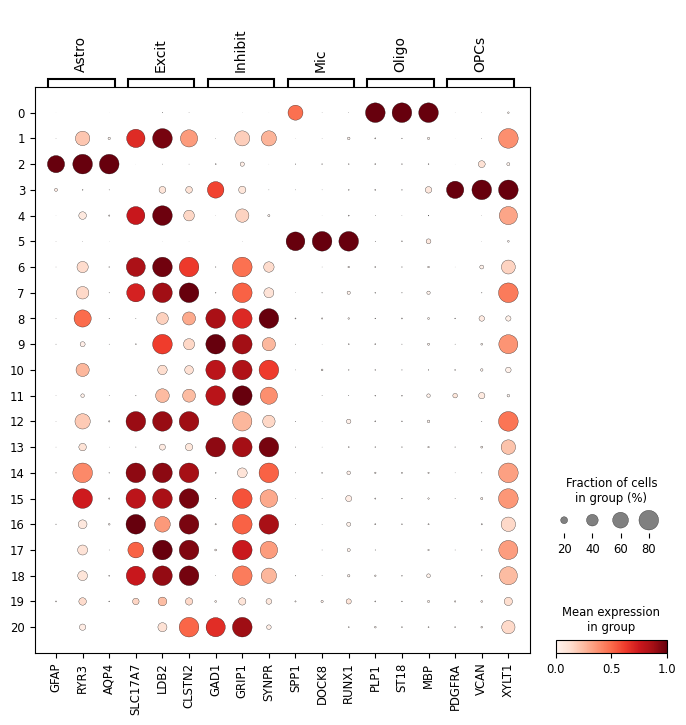

In [ ]:
marker_genes = {
    "Astro": ["GFAP", "RYR3", "AQP4"],
    "Excit": ["SLC17A7", "LDB2", "CLSTN2"],
    "Inhibit": ["GAD1", "GRIP1", "SYNPR"],
    "Mic": ["SPP1","DOCK8", "RUNX1"],
    "Oligo": ["PLP1", "ST18", "MBP"],
    "OPCs" : ["PDGFRA", "VCAN", "XYLT1"]
}

marker_genes_present = {
    ct: [g for g in genes if g in adata.var_names]
    for ct, genes in marker_genes.items()
}

sc.pl.dotplot(
    adata,
    marker_genes_present,
    groupby="overcluster",
    standard_scale="var",
    dot_max=0.8,
    use_raw=False
)

In [23]:
sc.tl.rank_genes_groups(adata, groupby = 'overcluster', method='wilcoxon',use_raw=False)

c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:456: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:458: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\scanpy\tools\_rank_gene

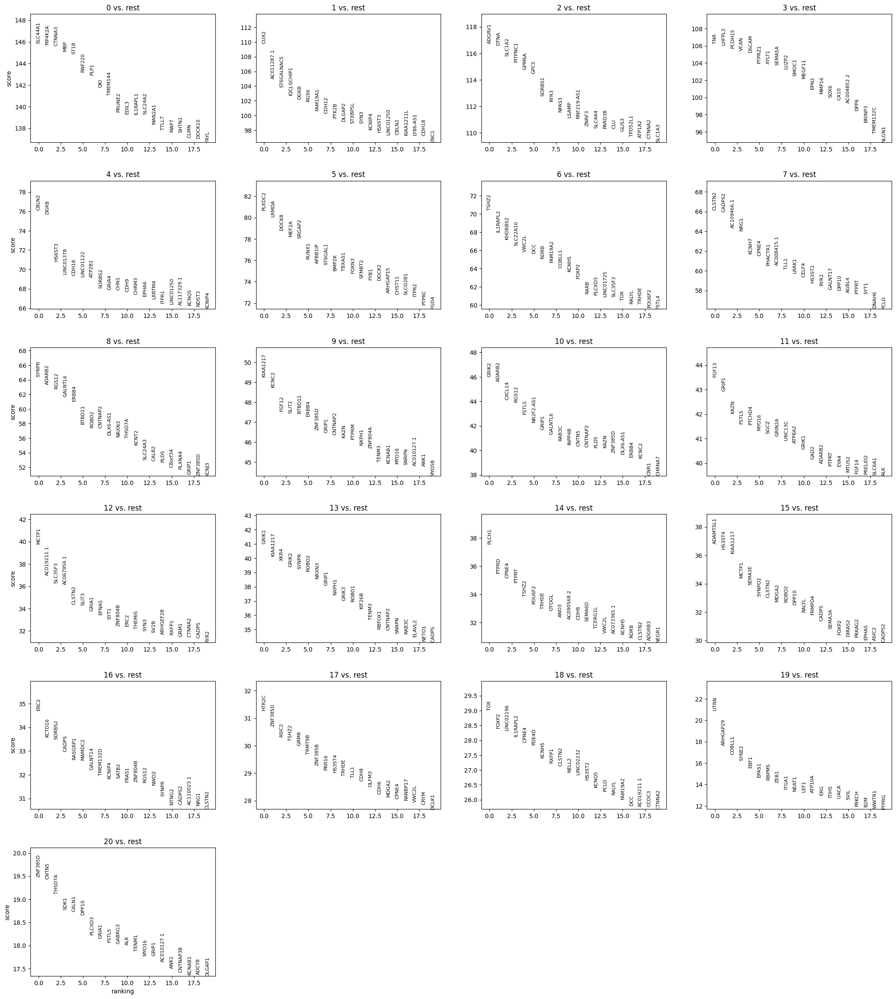

In [24]:
sc.pl.rank_genes_groups(adata, n_genes=20, sharey=False)

In [31]:
import celltypist
from celltypist import models

In [32]:
model = models.Model.load(model = r'GSE188545_RAW\clean_data\celltypist_models\Adult_Human_MTG.pkl')

In [33]:
model.cell_types

array(['Astro_1', 'Astro_2', 'Astro_3', 'Astro_4', 'Astro_5',
       'Chandelier_1', 'Chandelier_2', 'Endo_1', 'Endo_2', 'Endo_3',
       'L2/3 IT_1', 'L2/3 IT_10', 'L2/3 IT_12', 'L2/3 IT_13', 'L2/3 IT_2',
       'L2/3 IT_3', 'L2/3 IT_5', 'L2/3 IT_6', 'L2/3 IT_7', 'L2/3 IT_8',
       'L4 IT_1', 'L4 IT_2', 'L4 IT_3', 'L4 IT_4', 'L5 ET_1', 'L5 ET_2',
       'L5 IT_1', 'L5 IT_2', 'L5 IT_3', 'L5 IT_5', 'L5 IT_6', 'L5 IT_7',
       'L5/6 NP_1', 'L5/6 NP_2', 'L5/6 NP_3', 'L5/6 NP_4', 'L5/6 NP_6',
       'L6 CT_1', 'L6 CT_2', 'L6 CT_3', 'L6 CT_4', 'L6 IT Car3_1',
       'L6 IT Car3_2', 'L6 IT Car3_3', 'L6 IT_1', 'L6 IT_2', 'L6b_1',
       'L6b_2', 'L6b_3', 'L6b_4', 'L6b_5', 'L6b_6', 'Lamp5_1', 'Lamp5_2',
       'Lamp5_3', 'Lamp5_4', 'Lamp5_5', 'Lamp5_6', 'Lamp5_Lhx6_1',
       'Micro-PVM_1', 'Micro-PVM_2', 'OPC_1', 'OPC_2', 'Oligo_1',
       'Oligo_2', 'Oligo_3', 'Oligo_4', 'Pax6_1', 'Pax6_2', 'Pax6_3',
       'Pax6_4', 'Pvalb_1', 'Pvalb_10', 'Pvalb_12', 'Pvalb_13',
       'Pvalb_14', 'Pvalb_

In [34]:
predictions = celltypist.annotate(adata, model = 'GSE188545_RAW\clean_data\celltypist_models\Adult_Human_MTG.pkl', use_GPU=True, majority_voting=True)

<>:1: SyntaxWarning: invalid escape sequence '\c'
<>:1: SyntaxWarning: invalid escape sequence '\c'
C:\Users\User\AppData\Local\Temp\ipykernel_30076\3332707838.py:1: SyntaxWarning: invalid escape sequence '\c'
  predictions = celltypist.annotate(adata, model = 'GSE188545_RAW\clean_data\celltypist_models\Adult_Human_MTG.pkl', use_GPU=True, majority_voting=True)
⚠️ Warning: invalid expression matrix, expect ALL genes and log1p normalized expression to 10000 counts per cell. The prediction result may not be accurate
🔬 Input data has 40747 cells and 23124 genes
🔗 Matching reference genes in the model
🧬 4650 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
⚠️ Warning: rapids_singlecell is not installed but required for GPU running, will switch back to CPU
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 20
🗳️ Majority voting the predictions
✅ Majorit

In [35]:
predictions.predicted_labels

,predicted_labels,over_clustering,majority_voting
AAAGGGCTCTGCGGAC-1-AD02MTG,Micro-PVM_2,0,Micro-PVM_2
AAAGGTAAGAACTCCT-1-AD02MTG,Astro_2,1,Astro_3
AAAGGTAGTGTATTGC-1-AD02MTG,Astro_5,2,Astro_2
AAAGTCCTCTTTCCAA-1-AD02MTG,Astro_2,2,Astro_2
AAATGGAGTTAGGAGC-1-AD02MTG,Micro-PVM_2,0,Micro-PVM_2
...,...,...,...
TTTGGTTTCGCATAGT-1-HC37MTG,L2/3 IT_1,251,L2/3 IT_1
TTTGGTTTCTGTAACG-1-HC37MTG,OPC_2,242,OPC_2
TTTGTTGAGAGAGCCT-1-HC37MTG,L2/3 IT_1,230,L2/3 IT_1
TTTGTTGGTAGGTGCA-1-HC37MTG,L6 IT Car3_3,198,L6 IT Car3_3


In [36]:
adata.obs['Celltypist_MTG'] = predictions.predicted_labels['majority_voting']

In [38]:
mapping_dict = {

    # Astrocytes
    'Astro': 'Astro',

    # Microglia
    'Micro': 'Mic',

    # OPCs
    'OPC': 'OPCs',

    # Oligodendrocytes
    'Oligo': 'Oligo',

    # Inhibitory neurons
    'Pvalb': 'Inhibit',
    'Sst': 'Inhibit',
    'Vip': 'Inhibit',
    'Chandelier': 'Inhibit',
    'Sncg': 'Inhibit',

    # Excitatory neurons
    'L2': 'Excit',
    'L4': 'Excit',
    'L5': 'Excit',
    'L6': 'Excit',
    'Lamp5': 'Excit',
    'Pax6': 'Excit',
    'Car3': 'Excit',
}

def collapse_label(label):
    for prefix, broad in mapping_dict.items():
        if label.startswith(prefix):
            return broad
    return 'Other'  # Endo, VLMC, etc.

adata.obs['broad_type_celltypist_mtg'] = adata.obs['Celltypist_MTG'].apply(collapse_label).astype('category')


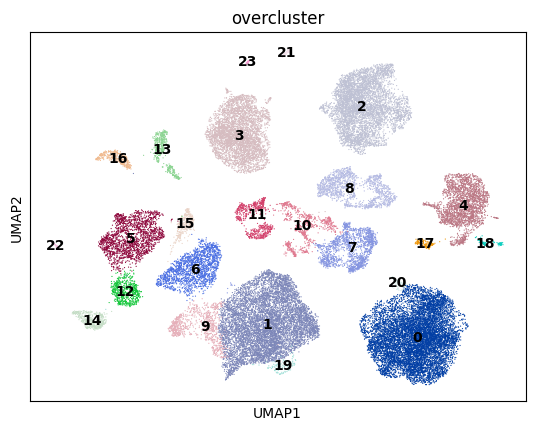

In [37]:
sc.pl.umap(adata, color=["overcluster"], legend_loc="on data")

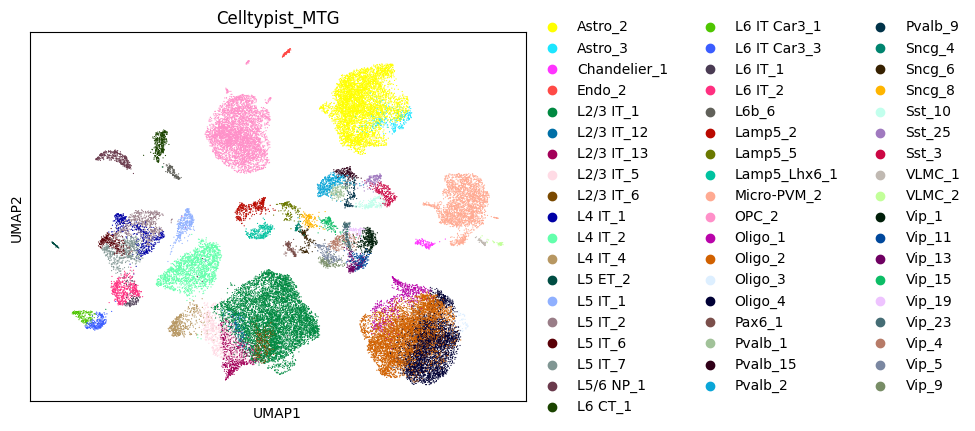

In [39]:
sc.pl.umap(adata, color='Celltypist_MTG')

In [13]:
annotation_map = {
    '1': 'Excit','4': 'Excit','6': 'Excit','7': 'Excit','12': 'Excit','14': 'Excit','15': 'Excit','16': 'Excit','17': 'Excit','18': 'Excit',
    '8': 'Inhibit','9': 'Inhibit','10': 'Inhibit','11': 'Inhibit','13': 'Inhibit',
    '2': 'Astro',
    '0': 'Oligo',
    '3': 'OPCs',
    '5': 'Mic',
    '19': 'Other','20': 'Other',
}

adata.obs['cell_type'] = adata.obs['overcluster'].map(annotation_map)
print("Conteo de células por tipo celular anotado:")
print(adata.obs['cell_type'].value_counts())
adata.obs['cell_type'] = adata.obs['cell_type'].astype('category')

Conteo de células por tipo celular anotado:
cell_type
Excit      14680
Oligo       9374
Astro       5276
Inhibit     4479
OPCs        4217
Mic         2344
Other        440
Name: count, dtype: int64


In [23]:
marker_genes_present

{'Astro': ['GFAP', 'RYR3', 'AQP4'],
 'Excit': ['SLC17A7', 'LDB2', 'CLSTN2'],
 'Inhibit': ['GAD1', 'GRIP1', 'SYNPR'],
 'Mic': ['SPP1', 'DOCK8', 'RUNX1'],
 'Oligo': ['PLP1', 'ST18', 'MBP'],
 'OPCs': ['PDGFRA', 'VCAN', 'XYLT1']}

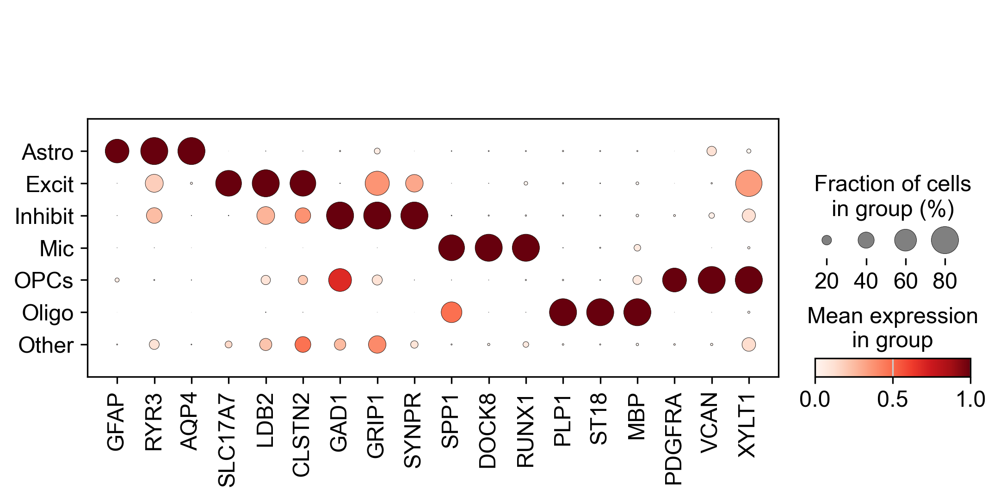

In [93]:
sc.settings.set_figure_params(
    dpi=150,
    fontsize=14
)

sc.pl.dotplot(
    adata,
    var_names= ['GFAP', 'RYR3', 'AQP4','SLC17A7', 'LDB2', 'CLSTN2','GAD1', 'GRIP1', 'SYNPR','SPP1', 'DOCK8', 'RUNX1','PLP1', 'ST18', 'MBP','PDGFRA', 'VCAN', 'XYLT1'],
    groupby="cell_type",
    standard_scale="var",
    dot_max=0.8,
    use_raw=False
)

In [ ]:
adata.obs['Condition'] = adata.obs['Patient'].str[:2]
fig, axs = plt.subplots(1, 2, figsize=(12, 5))
sc.pl.umap(adata[adata.obs['Condition'] == 'AD'],color='cell_type',title='Alzheimer (AD)',ax=axs[0],show=False)
sc.pl.umap(adata[adata.obs['Condition'] == 'HC'],color='cell_type',title='Control (HC)',ax=axs[1],show=False)
fig.suptitle('MTG UMAP AD vs NC', fontsize=16)
plt.tight_layout()
plt.show()

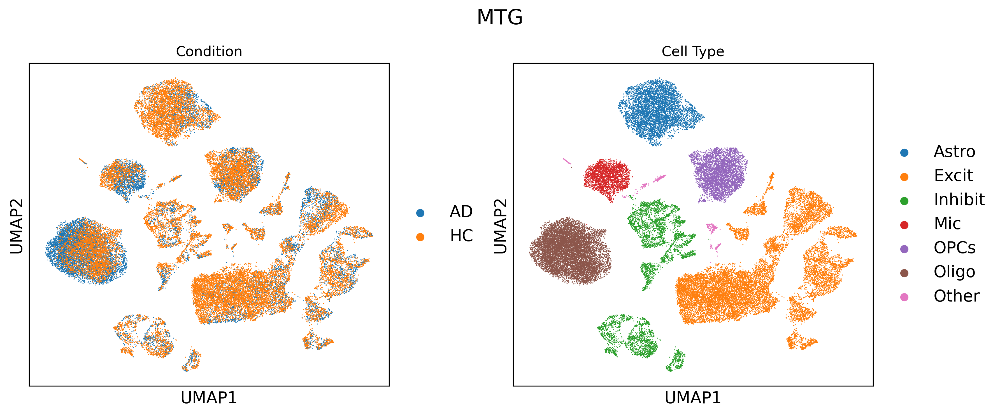

In [15]:
import matplotlib.pyplot as plt
import scanpy as sc

# Mejorar calidad de la figura
plt.rcParams['figure.dpi'] = 300
plt.rcParams['savefig.dpi'] = 300

fig, axs = plt.subplots(1, 2, figsize=(12, 5))

sc.pl.umap(
    adata,
    color='Condition',
    title='Condition',
    ax=axs[0],
    show=False,
    legend_fontsize=14
)

sc.pl.umap(
    adata,
    color='cell_type',
    title='Cell Type',
    ax=axs[1],
    show=False,
    legend_fontsize=14
)

# Ajustar ejes y ticks
for ax in axs:
    ax.set_xlabel('UMAP1', fontsize=14)
    ax.set_ylabel('UMAP2', fontsize=14)
    ax.tick_params(axis='both', labelsize=14)

fig.suptitle('MTG', fontsize=18)
plt.tight_layout()
plt.show()


In [48]:
sc.tl.rank_genes_groups(adata, groupby='cell_type', method='wilcoxon',use_raw=False)

In [49]:
top_genes_nombres = pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(3)

print(top_genes_nombres)

    Astro  Excit  Inhibit     Mic    OPCs    Oligo     Other
0  ADGRV1  RALYL    GRIP1  PLXDC2     TNR  SLC44A1      UTRN
1    DTNA   LDB2  CNTNAP2   LRMDA  LHFPL3  PIP4K2A  ARHGAP29
2  SLC1A2  NELL2     KAZN   DOCK8  PCDH15   CTNNA3    COBLL1


<>:25: SyntaxWarning: invalid escape sequence '\p'
<>:25: SyntaxWarning: invalid escape sequence '\p'
C:\Users\User\AppData\Local\Temp\ipykernel_18716\2765410181.py:25: SyntaxWarning: invalid escape sequence '\p'
  'Proporción de Núcleos por Tipo Celular (Media $\pm$ SEM)',
C:\Users\User\AppData\Local\Temp\ipykernel_18716\2765410181.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_counts = adata.obs.groupby(['Patient', 'Condition', 'cell_type']).size().reset_index(name='N')
C:\Users\User\AppData\Local\Temp\ipykernel_18716\2765410181.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_total_

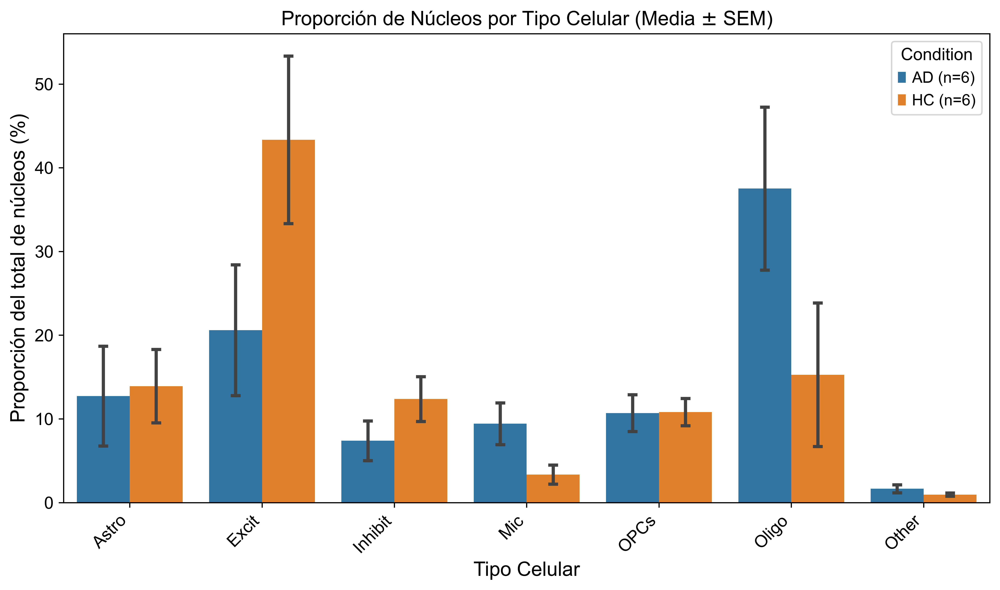

In [96]:
patient_counts = adata.obs.groupby(['Patient', 'Condition', 'cell_type']).size().reset_index(name='N')

patient_total_N = adata.obs.groupby(['Patient', 'Condition']).size().reset_index(name='Total_N')

proportions_per_patient = pd.merge(patient_counts, patient_total_N, on=['Patient', 'Condition'])
proportions_per_patient['Proportion'] = (proportions_per_patient['N'] / proportions_per_patient['Total_N']) * 100

proportions_per_patient['Condition'] = proportions_per_patient['Condition'].replace({
    'AD': 'AD (n=6)', 
    'HC': 'HC (n=6)'
})
plt.rcParams['figure.dpi'] = 300
plt.figure(figsize=(10, 6))

sns.barplot(
    data=proportions_per_patient,
    x='cell_type',
    y='Proportion',
    hue='Condition',
    errorbar='se',
    capsize=0.1
)

plt.title(
    'Proporción de Núcleos por Tipo Celular (Media $\pm$ SEM)',
    fontsize=14
)
plt.ylabel('Proporción del total de núcleos (%)', fontsize=14)
plt.xlabel('Tipo Celular', fontsize=14)

plt.xticks(rotation=45, ha='right', fontsize=12)
plt.yticks(fontsize=12)

plt.legend(title='Condition', title_fontsize=12, fontsize=11)

plt.tight_layout()
plt.grid(axis='y')

plt.show()

In [ ]:
summary_stats = proportions_per_patient.groupby(['Condition', 'cell_type'])['Proportion'].agg(['mean', 'sem']).reset_index()

summary_stats.columns = ['Condition', 'cell_type', 'Average_Percentage', 'Error_Bar_SEM']

summary_stats['Average_Percentage'] = summary_stats['Average_Percentage'].round(2)
summary_stats['Error_Bar_SEM'] = summary_stats['Error_Bar_SEM'].round(2)

print(summary_stats)


   Condition cell_type  Average_Percentage  Error_Bar_SEM
0   AD (n=6)     Astro               12.73           5.95
1   AD (n=6)     Excit               20.60           7.81
2   AD (n=6)   Inhibit                7.39           2.37
3   AD (n=6)       Mic                9.43           2.49
4   AD (n=6)      OPCs               10.69           2.20
5   AD (n=6)     Oligo               37.52           9.73
6   AD (n=6)     Other                1.65           0.48
7   HC (n=6)     Astro               13.91           4.39
8   HC (n=6)     Excit               43.34          10.01
9   HC (n=6)   Inhibit               12.38           2.67
10  HC (n=6)       Mic                3.34           1.14
11  HC (n=6)      OPCs               10.81           1.63
12  HC (n=6)     Oligo               15.28           8.57
13  HC (n=6)     Other                0.95           0.19


C:\Users\User\AppData\Local\Temp\ipykernel_18716\1866980850.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  summary_stats = proportions_per_patient.groupby(['Condition', 'cell_type'])['Proportion'].agg(['mean', 'sem']).reset_index()


In [109]:
deg_results = {}

cell_types = adata.obs['cell_type'].unique()

for ct in cell_types:
    adata_subset = adata[adata.obs['cell_type'] == ct].copy()
    

    sc.tl.rank_genes_groups(adata_subset, groupby='Condition', reference='HC', method='wilcoxon', use_raw = False)
    
    df_results = sc.get.rank_genes_groups_df(adata_subset, group='AD')
    
    df_results = df_results[df_results['pvals_adj'] < 0.05]
    df_results = df_results[(df_results['logfoldchanges'] >= 0.25) | 
                            (df_results['logfoldchanges'] <= -0.25)]

    deg_results[ct] = df_results

In [110]:
rows = []

for ct, df in deg_results.items():
    n_up   = (df['logfoldchanges'] >= 0.1).sum()
    n_down = (df['logfoldchanges'] <= -0.1).sum()

    rows.append({
        'cell_type': ct,
        'Up': n_up,
        'Down': n_down
    })

df_table = pd.DataFrame(rows).set_index('cell_type')
orden = ["Excit", "Inhibit", "Mic", "Astro", "Oligo", "OPCs", "Other"]
df_table = df_table.reindex(orden)
df_table.columns = pd.MultiIndex.from_product([['AD vs NC (CPF)'], df_table.columns])
df_table_renamed = df_table.rename_axis('Tipo de célula')

df_table_renamed

AD vs NC (CPF)     
                           Up Down
Tipo de célula                    
Excit                     282  681
Inhibit                    60  943
Mic                       224  164
Astro                     155  533
Oligo                     159  255
OPCs                      191  372
Other                      13  394

c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\upsetplot\data.py:385: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df.fillna(False, inplace=True)
c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\upsetplot\plotting.py:795: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.

<Figure size 3600x1800 with 0 Axes>

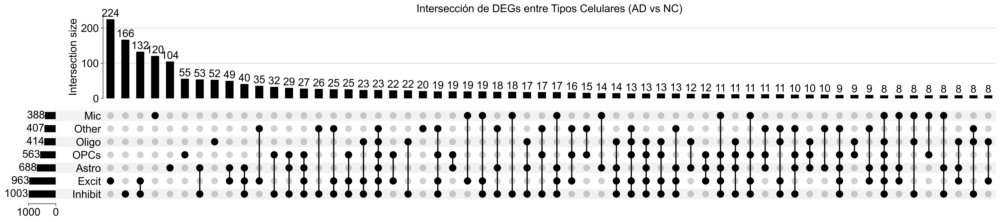

In [ ]:
import matplotlib.pyplot as plt
from upsetplot import from_contents, UpSet

gene_sets = {}
plt.rcParams.update({
    'font.size': 18,
    'axes.labelsize': 18,
    'xtick.labelsize': 18,
    'ytick.labelsize': 18,
    'axes.titlesize': 18,
    'figure.dpi': 300
})
for cell_type, df in deg_results.items():
    sig_genes = df[
        (df['pvals_adj'] < 0.05) & 
        (abs(df['logfoldchanges']) > 0.25)
    ]['names'].tolist()
    
    gene_sets[cell_type] = sig_genes

upset_data = from_contents(gene_sets)

plt.figure(figsize=(12, 6))
upset = UpSet(upset_data, subset_size='count', show_counts=True, sort_by='cardinality', min_subset_size = 8)
upset.plot()

plt.title("Intersección de DEGs entre Tipos Celulares (AD vs NC)")
plt.show()

In [106]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Ajuste de tamaño de fuente para que tu tutora esté contenta
plt.rcParams.update({'font.size': 12}) 

LOG_FOLD_CHANGE = 0.25
P_VALUE_THRESHOLD = 0.01 # Umbral de p-valor (línea horizontal)

def volcano_plot_custom(deg_results, cell_type, title=None):
    df = deg_results[cell_type].copy()

    # Calcular la transformación logarítmica para el eje Y
    # Nos aseguramos de que sea float para evitar errores
    df["pvals_adj"] = df["pvals_adj"].astype(float)
    df["-logQ"] = -np.log10(df["pvals_adj"] + 1e-300)

    # --- AQUÍ ESTÁ LA CORRECCIÓN ---
    # Para ser ROJO (significativo) debe cumplir AMBAS condiciones:
    # 1. Fold change absoluto mayor que el límite
    # 2. P-valor menor que el límite (0.1)
    condition_significant = (abs(df["logfoldchanges"]) > LOG_FOLD_CHANGE) & \
                            (df["pvals_adj"] < P_VALUE_THRESHOLD)

    lowqval_de = df.loc[condition_significant]  # Puntos rojos (Cumplen todo)
    other_de = df.loc[~condition_significant]   # Puntos grises (Fallan en algo)

    fig, ax = plt.subplots(figsize=(8, 6))

    # Puntos grises (No significativos o poco cambio)
    sns.regplot(
        x=other_de["logfoldchanges"],
        y=other_de["-logQ"],
        fit_reg=False,
        scatter_kws={"s": 10, "color": "grey", "alpha": 0.5},
        ax=ax
    )

    # Puntos rojos (Significativos Y con cambio relevante)
    sns.regplot(
        x=lowqval_de["logfoldchanges"],
        y=lowqval_de["-logQ"],
        fit_reg=False,
        scatter_kws={"s": 20, "color": "red", "alpha": 0.8},
        ax=ax
    )

    # Etiquetas ejes (Más grandes)
    ax.set_xlabel("log2 Fold Change", fontsize=20)
    ax.set_ylabel("-log10 (adj P-value)", fontsize=20)
    ax.tick_params(axis='both', which='major', labelsize=20)

    # Líneas Verticales (Fold Change)
    ax.axvline(LOG_FOLD_CHANGE, color='k', ls='--', lw=0.8)
    ax.axvline(-LOG_FOLD_CHANGE, color='k', ls='--', lw=0.8)

    # Línea Horizontal (P-value = 0.1)
    # -log10(0.1) es igual a 1.0
    y_pos = -np.log10(P_VALUE_THRESHOLD)
    ax.axhline(y_pos, color='k', ls='--', lw=0.8)
    ax.set_xlim(-10, 10)
    if title is None:
        title = f"MTG: DEGs {cell_type} (AD vs NC)"
    plt.title(title, fontsize=16)
    
    sns.despine()
    plt.show()

In [ ]:
volcano_plot_custom(deg_results, "Oligo")
volcano_plot_custom(deg_results, "Astro")
volcano_plot_custom(deg_results, "Excit")
volcano_plot_custom(deg_results, "Inhibit")

C:\Users\User\AppData\Local\Temp\ipykernel_18716\1828550239.py:50: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  plt.gca().set_xticklabels([str(abs(int(x))) for x in vals])


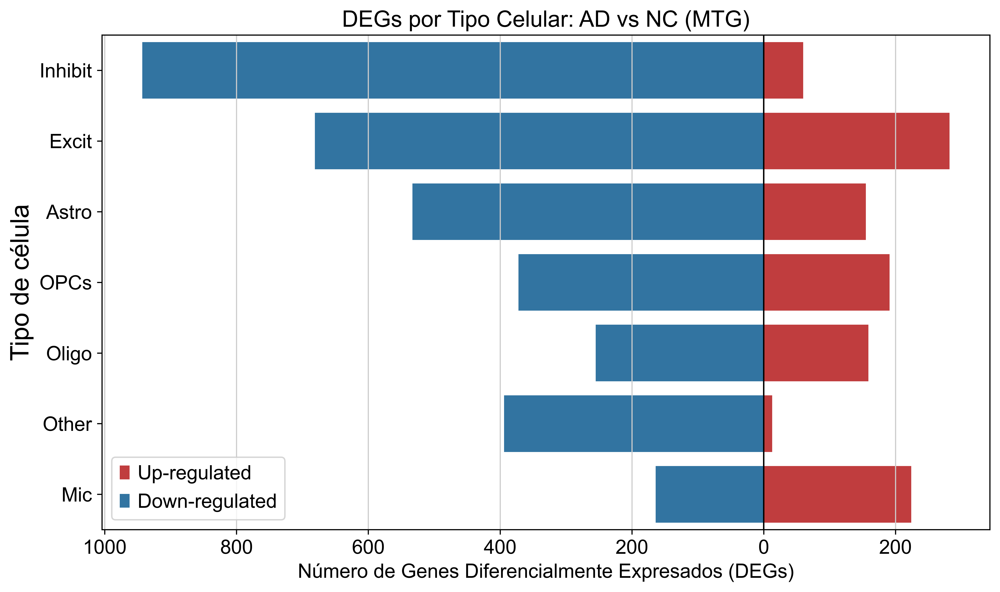

In [113]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

plot_data = df_table_renamed.copy()
plot_data.columns = ['Up', 'Down']
plot_data = plot_data.reset_index()

plot_data['Down_neg'] = plot_data['Down'] * -1

plot_data['Total'] = plot_data['Up'] + plot_data['Down']
plot_data = plot_data.sort_values('Total', ascending=False)

plt.figure(figsize=(10, 6))

sns.barplot(
    data=plot_data,
    x='Up',
    y='Tipo de célula',
    color='#d62728',
    label='Up-regulated'
)

sns.barplot(
    data=plot_data,
    x='Down_neg',
    y='Tipo de célula',
    color='#1f77b4',
    label='Down-regulated'
)

plt.axvline(0, color='black', linewidth=1)

plt.xlabel(
    'Número de Genes Diferencialmente Expresados (DEGs)',
    fontsize=14
)
plt.title(
    'DEGs por Tipo Celular: AD vs NC (MTG)',
    fontsize=16
)

plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

plt.legend(fontsize=14, title_fontsize=14, loc = 'lower left')

# Mostrar valores positivos en el eje X
vals = plt.gca().get_xticks()
plt.gca().set_xticklabels([str(abs(int(x))) for x in vals])

plt.tight_layout()
plt.show()

In [31]:
import pandas as pd
import sccoda.util.cell_composition_data as dat
import sccoda.util.comp_ana as mod

counts_df = pd.crosstab(adata.obs['Patient'], adata.obs['cell_type'])
counts_df = counts_df.reset_index()

meta_df = adata.obs[['Patient', 'Condition']].drop_duplicates()

counts_df['Patient'] = counts_df['Patient'].astype(str)
meta_df['Patient'] = meta_df['Patient'].astype(str)

data_merged = pd.merge(counts_df, meta_df, on='Patient', how='left')

data_merged = data_merged.set_index('Patient')
data_merged = data_merged.drop(['HC35MTG'])

print(data_merged.head())

data_sccoda = dat.from_pandas(
    data_merged,
    covariate_columns=["Condition"]
)

model = mod.CompositionalAnalysis(
    data_sccoda,
    formula="Condition",
    reference_cell_type="automatic" 
)

my_results = model.sample_hmc()
my_results.summary()

         Astro  Excit  Inhibit  Mic  OPCs  Oligo  Other Condition
Patient                                                          
AD02MTG    176      8        2   82    51     88     16        AD
AD04MTG    148    575      313  137   483    664     50        AD
AD12MTG    296   1881      296  128   359    672     31        AD
AD16MTG     64    502      310  214   319   1808     33        AD
AD17MTG    132     12        4  162   177   1811     35        AD
Automatic reference selection! Reference cell type set to Other


100%|██████████| 20000/20000 [01:08<00:00, 293.71it/s]


MCMC sampling finished. (85.575 sec)
Acceptance rate: 53.9%
Compositional Analysis summary:

Data: 11 samples, 7 cell types
Reference index: 6
Formula: Condition

Intercepts:
           Final Parameter  Expected Sample
Cell Type                                  
Astro                0.184       511.183048
Excit                0.319       585.067802
Inhibit             -0.277       322.378958
Mic                 -0.119       377.559337
OPCs                 0.209       524.123708
Oligo                1.011      1168.794017
Other               -0.924       168.802221


Effects:
                           Final Parameter  Expected Sample  log2-fold change
Covariate       Cell Type                                                    
Condition[T.HC] Astro             0.000000       661.403087          0.371690
                Excit             0.000000       757.000162          0.371690
                Inhibit           0.000000       417.115628          0.371690
                Mic         

# Subcluster analysis Oligo

# Up y downregulations + GO Analisis Oligodendrocitos

In [117]:
oligo_barcodes = adata.obs[adata.obs['cell_type'] == 'Oligo'].index
adata_full = adata.raw.to_adata()
adata_oligo = adata_full[oligo_barcodes].copy()
adata_oligo.obs = adata.obs.loc[oligo_barcodes].copy()

In [ ]:
sc.pp.normalize_total(adata_oligo)
sc.pp.log1p(adata_oligo)

adata_oligo.raw = adata_oligo 

sc.pp.highly_variable_genes(adata_oligo, flavor="seurat", n_top_genes=2000, subset=True)
sc.pp.scale(adata_oligo, max_value=10)
sc.pp.pca(adata_oligo)

sce.pp.harmony_integrate(adata_oligo, key='Patient') 

sc.pp.neighbors(adata_oligo, use_rep='X_pca_harmony')
sc.tl.umap(adata_oligo)
sc.tl.leiden(adata_oligo, resolution=0.4, key_added='leiden')
sc.pl.umap(adata_oligo, color=['leiden', 'Patient'])

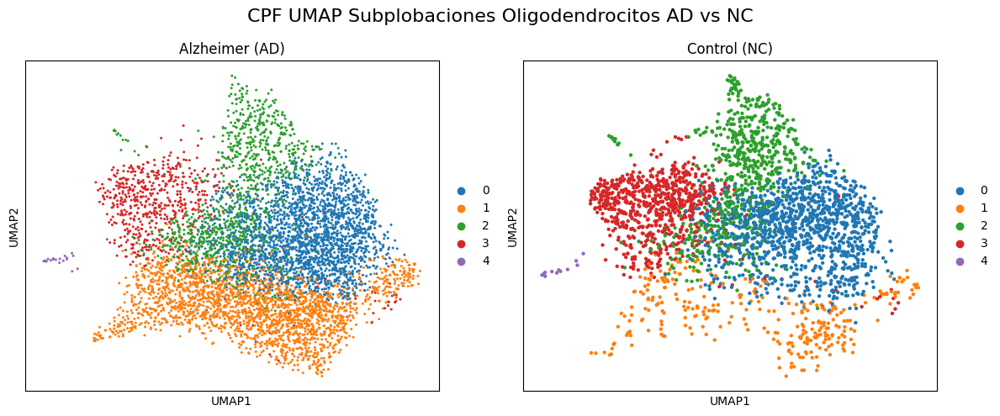

In [118]:
fig, axs = plt.subplots(1, 2, figsize=(12, 5))
sc.pl.umap(adata_oligo[adata_oligo.obs['Condition'] == 'AD'],color='leiden',title='Alzheimer (AD)',ax=axs[0],show=False)
sc.pl.umap(adata_oligo[adata_oligo.obs['Condition'] == 'HC'],color='leiden',title='Control (NC)',ax=axs[1],show=False)
fig.suptitle('CPF UMAP Subplobaciones Oligodendrocitos AD vs NC', fontsize=16)
plt.tight_layout()
plt.show()

In [119]:
adata_oligo.obs['Condition'] = adata_oligo.obs['Patient'].str[:2]

In [ ]:
import pandas as pd

ct = adata_oligo.obs.groupby(["leiden", "Condition"]).size().unstack(fill_value=0)

ct["prop_AD"] = ct["AD"] / ct["AD"].sum()
ct["prop_HC"] = ct["HC"] / ct["HC"].sum()

ct["delta"] = (ct["prop_AD"] - ct["prop_HC"]) * 100
ct_sorted = ct.sort_values("delta", ascending=False)

C:\Users\User\AppData\Local\Temp\ipykernel_4476\207311854.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  ct = adata_oligo.obs.groupby(["leiden", "Condition"]).size().unstack(fill_value=0)


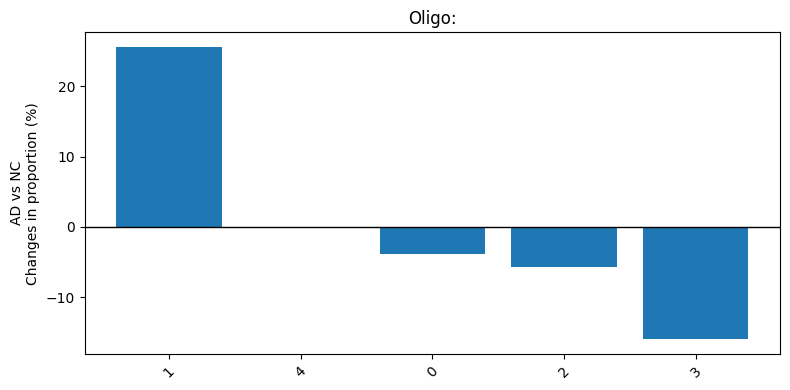

In [ ]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(8, 4))

x = range(len(ct_sorted))

ax.bar(x, ct_sorted["delta"])

ax.set_xticks(x)
ax.set_xticklabels(ct_sorted.index, rotation=45)

ax.axhline(0, color="black", linewidth=1)

# títulos
ax.set_ylabel("AD vs NC\nChanges in proportion (%)")
ax.set_title("Oligo:")

plt.tight_layout()
plt.show()


In [114]:
res_global

,names,scores,logfoldchanges,pvals,pvals_adj
0,FKBP5,38.923832,NaN,0.000000e+00,0.000000e+00
1,PTPRM,22.749928,NaN,1.437371e-114,2.395618e-112
2,MT3,18.989483,NaN,2.083671e-80,2.604589e-78
3,BCL2,18.572174,NaN,5.397242e-77,5.996936e-75
4,ABCA6,18.096329,NaN,3.406336e-73,3.244129e-71
...,...,...,...,...,...
1995,LSAMP,-25.648922,NaN,4.346669e-145,1.448890e-142
1996,NKAIN2,-31.128115,NaN,1.003341e-212,4.013364e-210
1997,NAALADL2,-32.053490,NaN,1.962733e-225,9.813667e-223
1998,NTM,-33.143261,NaN,7.082027e-241,4.721351e-238


Firma UP: 1009 genes | Firma DOWN: 1263 genes


C:\Users\User\AppData\Local\Temp\ipykernel_4476\2273069131.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cluster_means = df_expr.groupby(cluster_col).mean()


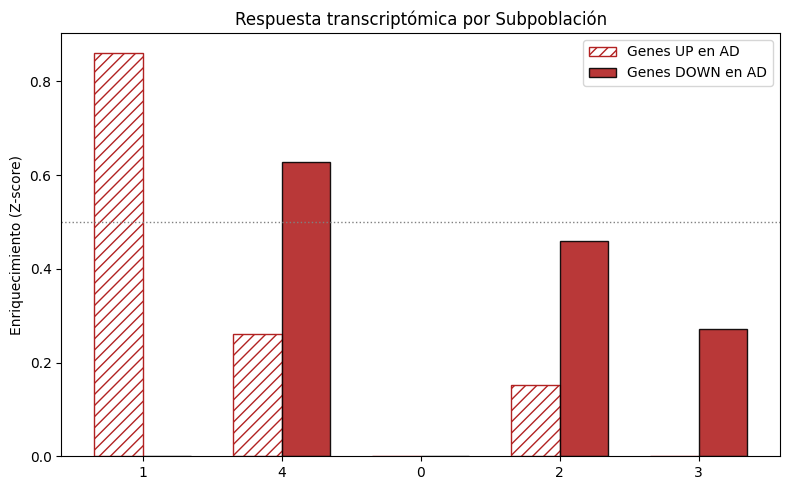

In [ ]:
sc.tl.rank_genes_groups(
    adata_oligo, 
    groupby='Condition', 
    reference='HC', 
    method='wilcoxon', 
    key_added='rank_genes_AD_vs_NC',
    use_raw=True 
)

res_global = sc.get.rank_genes_groups_df(adata_oligo, group='AD', key='rank_genes_AD_vs_NC')

up_signature = res_global[(res_global['pvals_adj'] < 0.1) & (res_global['logfoldchanges'] > 0.1)]['names'].tolist()
down_signature = res_global[(res_global['pvals_adj'] < 0.1) & (res_global['logfoldchanges'] < -0.1)]['names'].tolist()

print(f"Firma UP: {len(up_signature)} genes | Firma DOWN: {len(down_signature)} genes")

cluster_col = 'leiden'
genes_of_interest = list(set(up_signature + down_signature))

genes_of_interest = [g for g in genes_of_interest if g in adata_oligo.raw.var_names]

if len(genes_of_interest) > 0:

    raw_data = adata_oligo.raw[:, genes_of_interest].X

    if scipy.sparse.issparse(raw_data):
        raw_data = raw_data.toarray()
        
    df_expr = pd.DataFrame(
        raw_data,
        index=adata_oligo.obs_names,
        columns=genes_of_interest
    )
    df_expr[cluster_col] = adata_oligo.obs[cluster_col].values

    cluster_means = df_expr.groupby(cluster_col).mean()

    z_matrix = cluster_means.apply(zscore, axis=0).fillna(0)

    enrichment_scores = pd.DataFrame(index=cluster_means.index)
    
    valid_up = [g for g in up_signature if g in z_matrix.columns]
    valid_down = [g for g in down_signature if g in z_matrix.columns]

    enrichment_scores['Firma sobreexp.'] = z_matrix[valid_up].mean(axis=1)
    enrichment_scores['Firma subexp.'] = z_matrix[valid_down].mean(axis=1)
    
    enrichment_scores = enrichment_scores.loc[ct_sorted.index]

    fig, ax = plt.subplots(figsize=(8, 5))
    x = np.arange(len(enrichment_scores))
    width = 0.35

    up_values = enrichment_scores['Firma sobreexp.'].clip(lower=0)
    down_values = enrichment_scores['Firma subexp.'].clip(lower=0)

    ax.bar(x - width/2, up_values, width, label='Genes UP en AD', color='white', edgecolor='firebrick', hatch='///')
    ax.bar(x + width/2, down_values, width, label='Genes DOWN en AD', color='firebrick', edgecolor='black', alpha=0.9)

    ax.axhline(y=0.5, color='gray', linestyle=':', linewidth=1)
    ax.set_ylabel('Enriquecimiento (Z-score)')
    ax.set_xticks(x)
    ax.set_xticklabels(enrichment_scores.index)
    ax.legend()
    ax.set_title('Respuesta transcriptómica por Subpoblación')
    
    plt.tight_layout()
    plt.show()

In [116]:
import scanpy as sc
import pandas as pd

cluster_map = {
    '0': 'Downregulated',
    '1': 'Stable',
    '2': 'Stable',
    '3': 'Upregulated',
    '4': 'Downregulated',
    '5': 'Stable',
    '6': 'Stable' ,
    '7': 'Upregulated'
}

adata_oligo.obs['subpop_status'] = adata_oligo.obs['leiden_0.8'].map(cluster_map)

adata_oligo.obs['subpop_status'] = adata_oligo.obs['subpop_status'].fillna('Other')

print(adata_oligo.obs['subpop_status'].value_counts())

KeyError: 'leiden_0.8'

In [ ]:
sc.tl.rank_genes_groups(adata_oligo, groupby='subpop_status', method='wilcoxon', pts=True, use_raw=True)

... storing 'subpop_status' as categorical


In [ ]:
sc.pl.rank_genes_groups_heatmap(adata_oligo, groups=['Downregulated'], n_genes=20, show_gene_labels=True)

In [115]:
dedf = sc.get.rank_genes_groups_df(adata_oligo, group='Downregulated')
dedf

,names,scores,logfoldchanges,pvals,pvals_adj,pct_nz_group,pct_nz_reference
0,PLP1,30.756281,0.799700,1.007813e-207,2.331173e-203,0.972558,0.974972
1,LAMP2,24.522585,0.687308,8.484242e-133,9.812450e-129,0.894479,0.871693
2,FTH1,23.447933,1.092658,1.387680e-121,1.069948e-117,0.740608,0.630128
3,QDPR,23.157661,0.759043,1.217034e-118,7.037805e-115,0.860830,0.835894
4,GPRC5B,19.487577,0.586877,1.399529e-84,4.624644e-81,0.816727,0.794709
...,...,...,...,...,...,...,...
23126,GNAQ,-17.167837,-0.802516,4.623234e-66,6.086536e-63,0.284221,0.536670
23127,LSAMP,-17.186552,-0.883140,3.348598e-66,4.841026e-63,0.314930,0.553778
23128,NTM,-18.727112,-0.830619,2.976276e-78,8.605529e-75,0.495916,0.739268
23129,DOCK3,-20.262272,-0.996274,2.768865e-91,1.067444e-87,0.303169,0.589577


In [114]:
genes_significativos = dedf[
    (dedf['pvals_adj'] < 0.1) & 
    (dedf['logfoldchanges'] > 0.1)
].sort_values('logfoldchanges', ascending=False)

print(f"Genes encontrados: {len(genes_significativos)}")
print(genes_significativos[['names', 'logfoldchanges', 'pvals_adj']].head(10))

Genes encontrados: 4770
        names  logfoldchanges     pvals_adj
2973    CNTN1        3.420937  3.288541e-04
4034     SGCZ        3.171162  1.502703e-02
3029    LUZP2        2.796285  4.386934e-04
450     CSMD3        2.764514  7.896914e-19
2922     NAV3        2.679143  2.624347e-04
4917  MAP3K10        2.429024  8.944545e-02
4382    FADS2        2.289077  3.457699e-02
3826     PAK5        2.265313  7.675797e-03
4579   UQCRC1        2.208477  4.984752e-02
4509     PGK1        2.180553  4.391416e-02


In [ ]:
print(genes_significativos[['names', 'logfoldchanges', 'pvals_adj']].head(10))

lista_para_GO = genes_significativos['names'].tolist()

print(f"Tienes {len(lista_para_GO)} genes para analizar.")
print("Copia estos genes:")
print('\n'.join(lista_para_GO))

# Subcluster analysis OLIGO CON ITNEGRACION SCVI

In [ ]:
import scvi
import scanpy as sc

oligo_barcodes = adata.obs[adata.obs['cell_type'] == 'Oligo'].index
adata_full = adata.raw.to_adata()
adata_oligo = adata_full[oligo_barcodes].copy()
adata_oligo.obs = adata.obs.loc[oligo_barcodes].copy()

sc.pp.highly_variable_genes(
    adata_oligo, 
    flavor="seurat_v3", 
    n_top_genes=2000, 
    subset=False
)

adata_subset_oligo = adata_oligo[:, adata_oligo.var['highly_variable']].copy()

scvi.model.SCVI.setup_anndata(
    adata_subset_oligo, 
    categorical_covariate_keys=['Patient'], 
    continuous_covariate_keys=['pct_counts_mt', 'pct_counts_ribo']
)

model = scvi.model.SCVI(adata_subset_oligo, n_layers=2, n_latent=30, gene_likelihood="nb")
model.train(max_epochs=200, early_stopping=True, early_stopping_patience = 5)

adata_oligo.obsm['X_scVI'] = model.get_latent_representation()

sc.pp.normalize_total(adata_oligo)
sc.pp.log1p(adata_oligo)

adata_oligo.raw = adata_oligo 

sc.pp.neighbors(adata_oligo, use_rep='X_scVI')
sc.tl.umap(adata_oligo)

sc.tl.leiden(adata_oligo, resolution=0.3)

sc.pl.umap(adata_oligo, color=["leiden", "Patient"])

In [168]:
clusters = sorted(adata_oligo.obs['leiden'].unique(), key=int)
cluster_map = {cl: f"o{int(cl)+1}" for cl in clusters}

adata_oligo.obs['Ocluster'] = adata_oligo.obs['leiden'].map(cluster_map)

In [120]:
sc.tl.leiden(adata_oligo, resolution=0.9, key_added='leiden')
clusters = sorted(adata_oligo.obs['leiden'].unique(), key=int)
cluster_map = {cl: f"o{int(cl)+1}" for cl in clusters}

adata_oligo.obs['Ocluster'] = adata_oligo.obs['leiden'].map(cluster_map)

c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\scanpy\plotting\_utils.py:482: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\scanpy\plotting\_utils.py:482: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


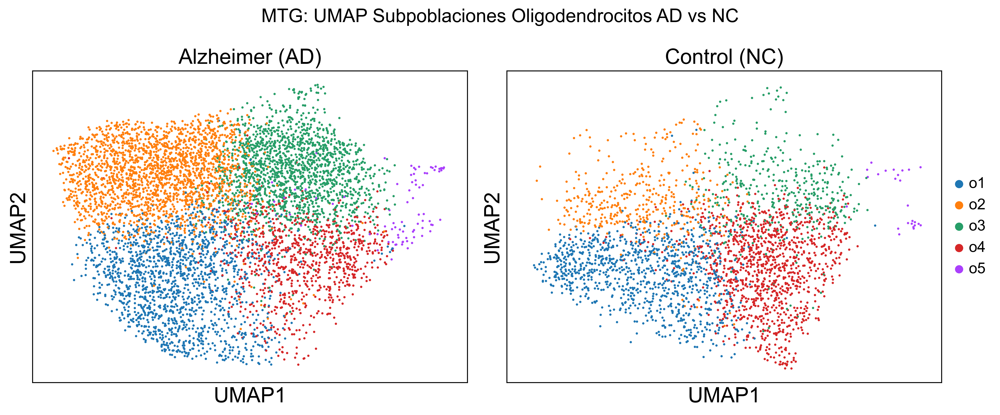

In [169]:
import matplotlib.pyplot as plt
umap_coords = adata_oligo.obsm['X_umap']
x_min, x_max = umap_coords[:, 0].min(), umap_coords[:, 0].max()
y_min, y_max = umap_coords[:, 1].min(), umap_coords[:, 1].max()
pad = 0.5 

fig, axs = plt.subplots(1, 2, figsize=(12, 5))
sc.pl.umap(adata_oligo[adata_oligo.obs['Condition'] == 'AD'], 
           color='Ocluster', title='Alzheimer (AD)', 
           ax=axs[0], show=False, size=15, legend_loc=None)
sc.pl.umap(adata_oligo[adata_oligo.obs['Condition'] == 'HC'], 
           color='Ocluster', title='Control (NC)', 
           ax=axs[1], show=False, size=15)
for ax in axs:
    ax.set_xlim(x_min - pad, x_max + pad)
    ax.set_ylim(y_min - pad, y_max + pad)

fig.suptitle('MTG: UMAP Subpoblaciones Oligodendrocitos AD vs NC', fontsize=16)
plt.tight_layout()
plt.show()

# Up y downregulations + GO Analisis Oligodendrocitos

In [174]:
adata_oligo.obs['Condition'] = adata_oligo.obs['Patient'].str[:2]

In [175]:
import pandas as pd

ct = adata_oligo.obs.groupby(["Ocluster", "Condition"]).size().unstack(fill_value=0)

ct["prop_AD"] = ct["AD"] / ct["AD"].sum()
ct["prop_NC"] = ct["HC"] / ct["HC"].sum()

ct["delta"] = (ct["prop_AD"] - ct["prop_NC"]) * 100
ct


C:\Users\User\AppData\Local\Temp\ipykernel_18716\4266839849.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  ct = adata_oligo.obs.groupby(["Ocluster", "Condition"]).size().unstack(fill_value=0)


Condition,AD,HC,prop_AD,prop_NC,delta
Ocluster,,,,,
o1,1578,1044,0.249092,0.343534,-9.444171
o2,2117,411,0.334175,0.135242,19.893336
o3,1669,415,0.263457,0.136558,12.689891
o4,886,1144,0.139858,0.376440,-23.658169
o5,85,25,0.013418,0.008226,0.519113


In [176]:
ct_sorted = ct.sort_values("delta", ascending=False)

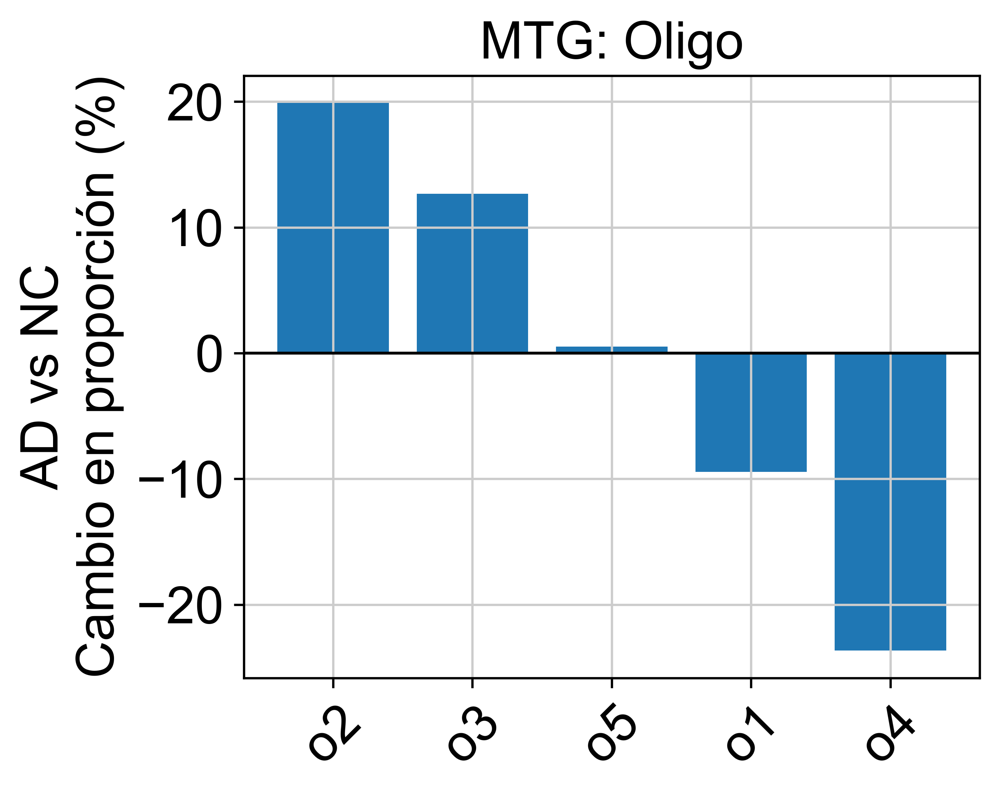

In [177]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(5, 4))

x = range(len(ct_sorted))

ax.bar(x, ct_sorted["delta"])

ax.set_xticks(x)
ax.set_xticklabels(ct_sorted.index, rotation=45)

ax.axhline(0, color="black", linewidth=1)

ax.set_ylabel("AD vs NC\nCambio en proporción (%)")
ax.set_title("MTG: Oligo")

plt.tight_layout()
plt.show()


Firma UP: 1009 genes | Firma DOWN: 1263 genes


C:\Users\User\AppData\Local\Temp\ipykernel_18716\780229853.py:37: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cluster_means = df_expr.groupby(cluster_col).mean()


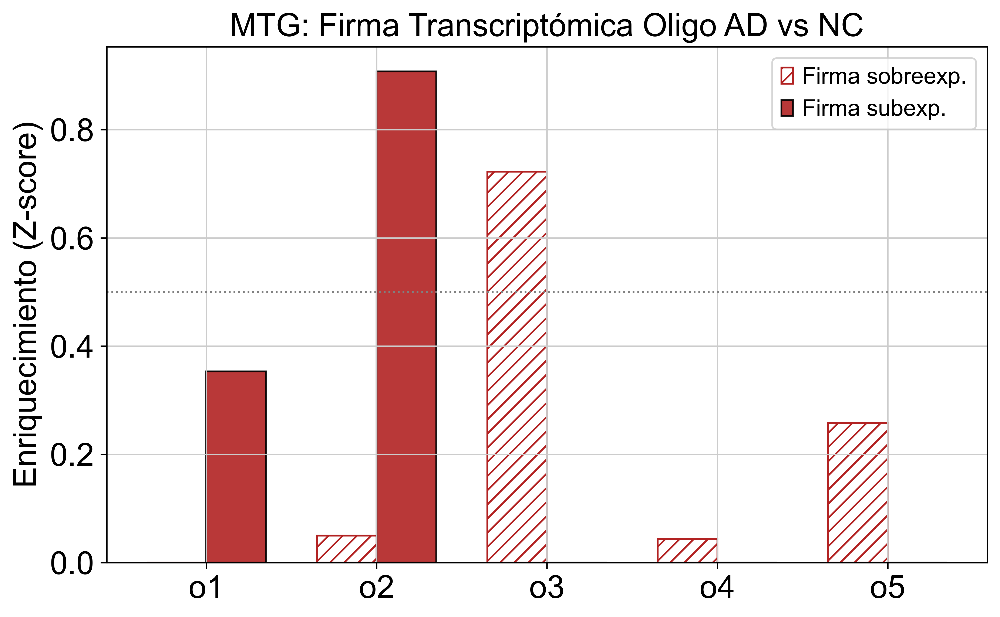

In [178]:
from scipy.stats import zscore

sc.tl.rank_genes_groups(
    adata_oligo,
    groupby='Condition',
    method='wilcoxon',
    use_raw=True,
    pts=True,
    key_added='rank_genes_AD_vs_NC'
)

res_global = sc.get.rank_genes_groups_df(adata_oligo, group='AD', key='rank_genes_AD_vs_NC')

up_signature = res_global[(res_global['pvals_adj'] < 0.1) & (res_global['logfoldchanges'] > 0.1)]['names'].tolist()
down_signature = res_global[(res_global['pvals_adj'] < 0.1) & (res_global['logfoldchanges'] < -0.1)]['names'].tolist()

print(f"Firma UP: {len(up_signature)} genes | Firma DOWN: {len(down_signature)} genes")

cluster_col = 'Ocluster'

genes_of_interest = list(set(up_signature + down_signature))

genes_of_interest = [g for g in genes_of_interest if g in adata_oligo.var_names]

data_subset = adata_oligo[:, genes_of_interest].X

if scipy.sparse.issparse(data_subset):
    data_subset = data_subset.toarray()
    
df_expr = pd.DataFrame(
    data_subset,
    index=adata_oligo.obs_names,
    columns=genes_of_interest
)
df_expr[cluster_col] = adata_oligo.obs[cluster_col].values

cluster_means = df_expr.groupby(cluster_col).mean()

z_matrix = cluster_means.apply(zscore, axis=0).fillna(0)

enrichment_scores = pd.DataFrame(index=cluster_means.index)

valid_up = [g for g in up_signature if g in z_matrix.columns]
valid_down = [g for g in down_signature if g in z_matrix.columns]

enrichment_scores['Firma sobreexp.'] = z_matrix[valid_up].mean(axis=1)
enrichment_scores['Firma subexp.'] = z_matrix[valid_down].mean(axis=1)* -1

fig, ax = plt.subplots(figsize=(8, 5))
x = np.arange(len(enrichment_scores))
width = 0.35

up_values = enrichment_scores['Firma sobreexp.'].clip(lower=0)
down_values = enrichment_scores['Firma subexp.'].clip(lower=0)

ax.bar(x - width/2, up_values, width, label='Firma sobreexp.', color='white', edgecolor='firebrick', hatch='///')
ax.bar(x + width/2, down_values, width, label='Firma subexp.', color='firebrick', edgecolor='black', alpha=0.9)

ax.axhline(y=0.5, color='gray', linestyle=':', linewidth=1)
ax.set_ylabel('Enriquecimiento (Z-score)')
ax.set_xticks(x)
ax.set_xticklabels(enrichment_scores.index)
ax.legend()
ax.set_title('MTG: Firma Transcriptómica Oligo AD vs NC')

plt.tight_layout()
plt.show()

In [180]:
cluster_map = {
    'o1': 'Stable',
    'o2': 'Downregulated',
    'o3': 'Upregulated',
    'o4': 'Stable',
    'o5': 'Stable'
}
adata_oligo.obs['subpop_status'] = adata_oligo.obs['Ocluster'].map(cluster_map)
adata_oligo.obs['subpop_status'] = adata_oligo.obs['subpop_status'].fillna('Other')
print(adata_oligo.obs['subpop_status'].value_counts())

sc.tl.rank_genes_groups(adata_oligo, groupby='subpop_status', method='wilcoxon', pts=True, use_raw=True)
dedf = sc.get.rank_genes_groups_df(adata_oligo, group='Downregulated')
genes_significativos = dedf[
    (dedf['pvals_adj'] < 0.05) & 
    (dedf['logfoldchanges'] > 0.25)
].sort_values('logfoldchanges', ascending=False)

print(f"Genes encontrados: {len(genes_significativos)}")

subpop_status
Stable           4762
Downregulated    2528
Upregulated      2084
Name: count, dtype: int64
Genes encontrados: 203


In [ ]:
print(genes_significativos[['names', 'logfoldchanges', 'pvals_adj']].head(10))

lista_para_GO = genes_significativos['names'].tolist()

print(f"Tienes {len(lista_para_GO)} genes para analizar.")
print("Copia estos genes:")
print('\n'.join(lista_para_GO))

          names  logfoldchanges     pvals_adj
145        CBR1        0.532839  9.240076e-03
118     SLC5A11        0.511880  1.980678e-05
1          CLMN        0.494238  3.193548e-98
4        PRUNE2        0.467261  1.729778e-88
44        NEAT1        0.454036  1.262960e-23
153  AC110285.1        0.444855  3.358928e-02
60       PIEZO2        0.423610  1.264973e-15
96      SELENOP        0.384328  1.018888e-07
3          ST18        0.379431  4.920582e-90
2       SLC44A1        0.375830  3.372305e-98
Tienes 189 genes para analizar.
Copia estos genes:
CBR1
SLC5A11
CLMN
PRUNE2
NEAT1
AC110285.1
PIEZO2
SELENOP
ST18
SLC44A1
C10orf90
RNF220
PIP4K2A
CRYAB
QDPR
SPOCK1
TMEM144
MBP
AC026316.5
CDK18
MAN2A1
TMTC2
ERBIN
CERCAM
ZNF536
MAP7
KCNMB4
ENPP2
DOCK5
NCKAP5
TMEM258
AC009063.2
PHGDH
FRYL
LAMP2
FRMD4B
AC016597.1
ELMO1
LINC01608
LRP2
SLC24A2
TTYH2
MAL
ADAMTS18
NDRG1
CNDP1
TMEM165
RGCC
AL359091.1
CCP110
SLC31A2
TTLL7
PXK
SLCO1A2
NKX6-2
POLR2F
ANLN
PEX5L
PLCL1
BAIAP2L2
TMCC2
AMER2
QKI
ANO4
ABCA6


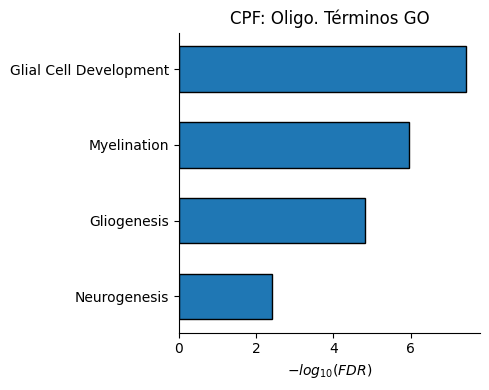

In [196]:
data = {
    'Term': [
            'Myelination',
            'Glial Cell Development',
            'Neurogenesis',
            'Gliogenesis'


    ],
    'FDR': [1.12E-06,3.78E-08,3.83E-03,1.55E-05]
}
df = pd.DataFrame(data)
df['log10_FDR'] = -np.log10(df['FDR'])
df = df.sort_values('log10_FDR', ascending=True)
fig, ax = plt.subplots(figsize=(5, 4))
bars = ax.barh(df['Term'], df['log10_FDR'], edgecolor='black', height=0.6)
ax.set_xlabel(r'$-log_{10}(FDR)$')
ax.set_title('CPF: Oligo. Términos GO')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
plt.tight_layout()
plt.show()

Calculando genes diferenciales...
Genes UP encontrados: 203
Genes DOWN encontrados: 3280

--- RESULTADOS HALLMARK (DOWN) ---
                       Term  Adjusted P-value  \
0         Protein Secretion      1.185733e-08   
1           Mitotic Spindle      4.227127e-06   
2            UV Response Dn      1.962338e-05   
3  PI3K/AKT/mTOR  Signaling      1.949625e-04   
4         Androgen Response      1.113955e-02   
5           heme Metabolism      4.810718e-02   
6           G2-M Checkpoint      1.436646e-01   
7          mTORC1 Signaling      1.436646e-01   
8           Notch Signaling      1.544633e-01   
9        TGF-beta Signaling      2.481281e-01   

                                               Genes  
0  COPB2;STX12;TSG101;SGMS1;COPB1;CLTC;SNAP23;USO...  
1  CEP57;DOCK4;WASL;PKD2;PCM1;CAPZB;KIF5B;CDC27;C...  
2  PHF3;YTHDC1;PTEN;MRPS31;PTPN21;PRDM2;VLDLR;NR3...  
3  GSK3B;CAB39;CAB39L;MAPKAP1;UBE2D3;CLTC;PTEN;IT...  
4  SRP19;NGLY1;STK39;GNAI3;PTPN21;CDC14B;ELK4;HER...  
5  US

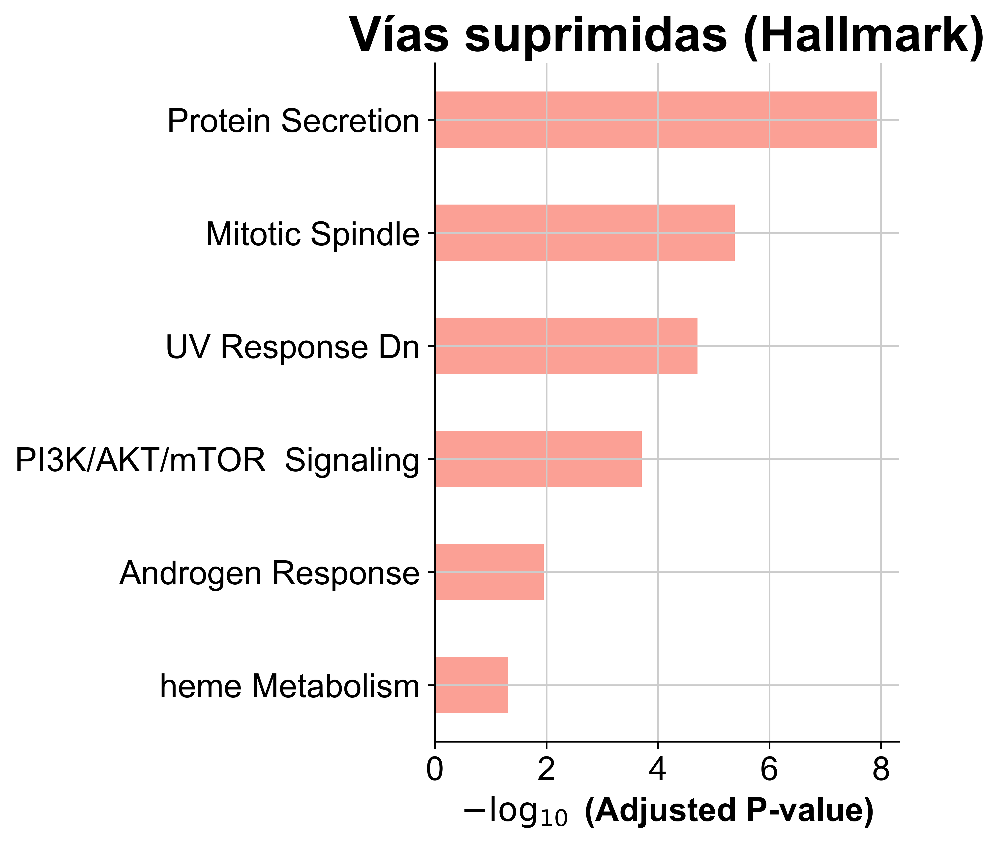


--- RESULTADOS HALLMARK (UP) ---
                                Term  Adjusted P-value  \
0                  Androgen Response          0.003103   
1                         Myogenesis          0.004565   
2            Cholesterol Homeostasis          0.007208   
3                   mTORC1 Signaling          0.007208   
4  Epithelial Mesenchymal Transition          0.007208   
5                        p53 Pathway          0.007208   
6                     UV Response Up          0.007208   
7               IL-2/STAT5 Signaling          0.023069   
8                        Coagulation          0.057952   
9    Reactive Oxygen Species Pathway          0.057952   

                                               Genes  
0           AZGP1;SCD;SELENOP;SGK1;B2M;NDRG1;SLC38A2  
1  GABARAPL2;SLC6A8;LAMA2;ERBB3;BIN1;SCD;APOD;CRY...  
2                         ABCA2;SCD;SEMA3B;CD9;DHCR7  
3        QDPR;PPA1;SCD;PRDX1;CD9;PHGDH;DHCR7;ADIPOR2  
4    SFRP1;SLC6A8;LAMA2;APLP1;SPP1;HTRA1;PMP22;EDIL3

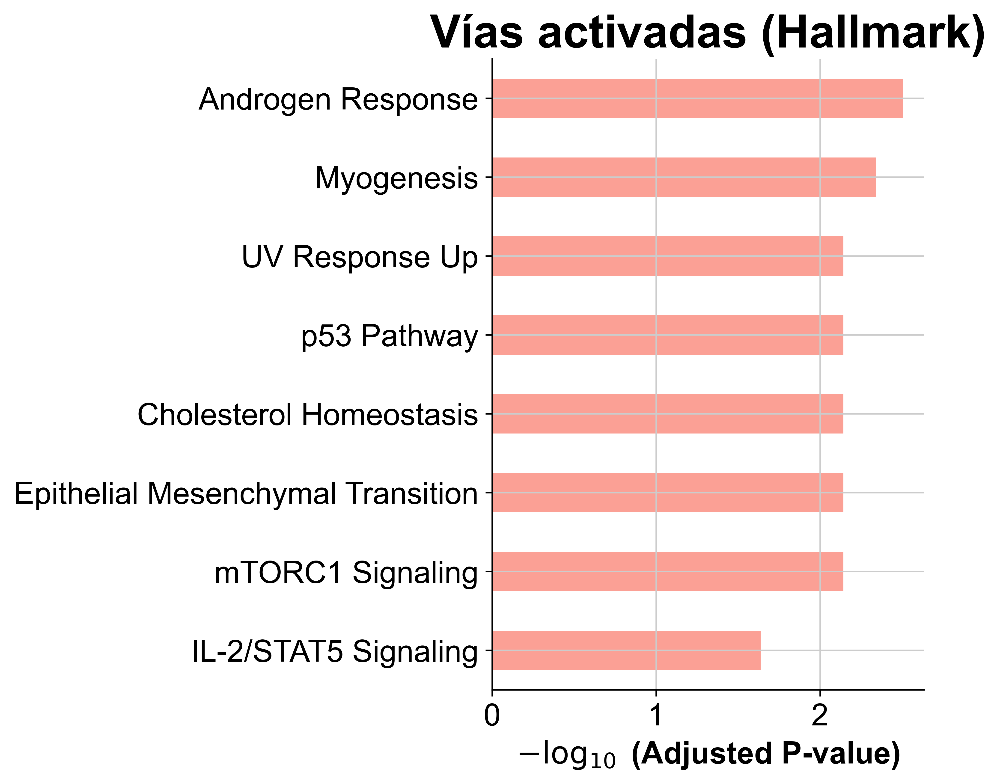

In [ ]:
import scanpy as sc
import gseapy as gp
import matplotlib.pyplot as plt

cluster_map = {
    'o1': 'Stable',
    'o2': 'Downregulated',
    'o3': 'Upregulated',
    'o4': 'Stable',
    'o5': 'Stable'
}
adata_oligo.obs['analysis_group'] = adata_oligo.obs['Ocluster'].map(cluster_map).fillna('Reference')


print("Calculando genes diferenciales...")
sc.tl.rank_genes_groups(adata_oligo, groupby='subpop_status', method='wilcoxon', pts=True, use_raw=True, n_genes=None)

dedf = sc.get.rank_genes_groups_df(adata_oligo, group='Downregulated')


genes_up = dedf[ (dedf['pvals_adj'] < 0.05) & (dedf['logfoldchanges'] > 0.25) ]['names'].tolist()
genes_down = dedf[ (dedf['pvals_adj'] < 0.05) & (dedf['logfoldchanges'] < -0.25) ]['names'].tolist()

print(f"Genes UP encontrados: {len(genes_up)}")
print(f"Genes DOWN encontrados: {len(genes_down)}")

if len(genes_down) > 5:
    enr_down = gp.enrichr(gene_list=genes_down,
                          gene_sets='MSigDB_Hallmark_2020',
                          organism='human', 
                          cutoff=0.05)
    
    if not enr_down.results.empty:
        print("\n--- RESULTADOS HALLMARK (DOWN) ---")
        print(enr_down.results[['Term', 'Adjusted P-value', 'Genes']].head(10))
        
        from gseapy import barplot
        ax = barplot(enr_down.res2d, title='Vías suprimidas (Hallmark)', cutoff=0.05)
        plt.show()
    else:
        print("No se encontraron vías significativas en DOWN.")
else:
    print("No hay suficientes genes DOWN para analizar.")

if len(genes_up) > 5:
    enr_up = gp.enrichr(gene_list=genes_up,
                        gene_sets='MSigDB_Hallmark_2020',
                        organism='human', 
                        cutoff=0.05)
    
    if not enr_up.results.empty:
        print("\n--- RESULTADOS HALLMARK (UP) ---")
        print(enr_up.results[['Term', 'Adjusted P-value', 'Genes']].head(10))
        
        ax = barplot(enr_up.res2d, title='Vías activadas (Hallmark)', cutoff=0.05)
        plt.show()

# Subcluster analysis Astro Integracion scvi CON TODOS LOS GENES

In [ ]:
astro_barcodes = adata.obs[adata.obs['cell_type'] == 'Astro'].index
adata_full = adata.raw.to_adata()
adata_astro = adata_full[astro_barcodes].copy()
adata_astro.obs = adata.obs.loc[astro_barcodes].copy()
sc.pp.highly_variable_genes(
    adata_astro, 
    flavor="seurat_v3", 
    n_top_genes=2000, 
    subset=False
)
adata_subset_oligo = adata_astro[:, adata_astro.var['highly_variable']].copy()
scvi.model.SCVI.setup_anndata(
    adata_subset_oligo, 
    categorical_covariate_keys=['Patient'], 
    continuous_covariate_keys=['pct_counts_mt', 'pct_counts_ribo']
)
model = scvi.model.SCVI(adata_subset_oligo, n_layers=2, n_latent=30, gene_likelihood="nb")
model.train(max_epochs=200, early_stopping=True, early_stopping_patience = 5)
adata_astro.obsm['X_scVI'] = model.get_latent_representation()
sc.pp.normalize_total(adata_astro)
sc.pp.log1p(adata_astro)
adata_astro.raw = adata_astro

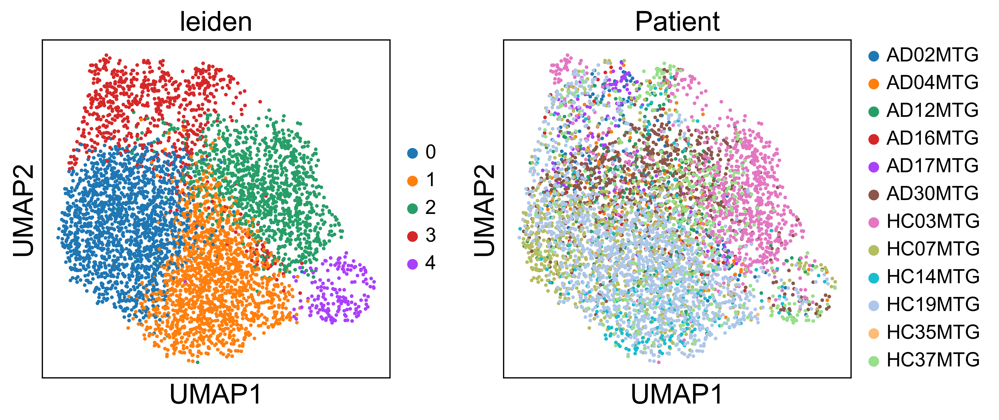

In [138]:
sc.pp.neighbors(adata_astro, use_rep='X_scVI')
sc.tl.umap(adata_astro)
sc.tl.leiden(adata_astro, resolution=0.5)
sc.pl.umap(adata_astro, color=["leiden", "Patient"])

In [139]:
clusters = sorted(adata_astro.obs['leiden'].unique(), key=int)
cluster_map = {cl: f"a{int(cl)+1}" for cl in clusters}

adata_astro.obs['Acluster'] = adata_astro.obs['leiden'].map(cluster_map)

c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\scanpy\plotting\_utils.py:482: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\scanpy\plotting\_utils.py:482: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


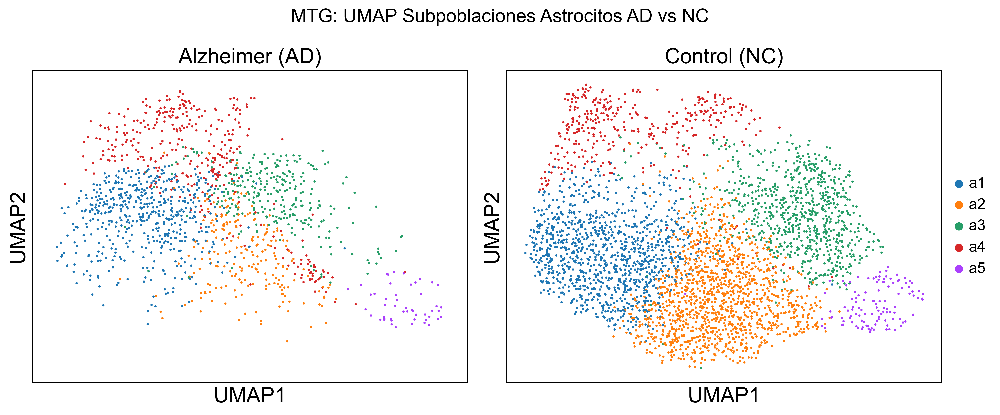

In [140]:
import matplotlib.pyplot as plt
umap_coords = adata_astro.obsm['X_umap']
x_min, x_max = umap_coords[:, 0].min(), umap_coords[:, 0].max()
y_min, y_max = umap_coords[:, 1].min(), umap_coords[:, 1].max()
pad = 0.5 

fig, axs = plt.subplots(1, 2, figsize=(12, 5))
sc.pl.umap(adata_astro[adata_astro.obs['Condition'] == 'AD'], 
           color='Acluster', title='Alzheimer (AD)', 
           ax=axs[0], show=False, size=15, legend_loc=None)
sc.pl.umap(adata_astro[adata_astro.obs['Condition'] == 'HC'], 
           color='Acluster', title='Control (NC)', 
           ax=axs[1], show=False, size=15)
for ax in axs:
    ax.set_xlim(x_min - pad, x_max + pad)
    ax.set_ylim(y_min - pad, y_max + pad)

fig.suptitle('MTG: UMAP Subpoblaciones Astrocitos AD vs NC', fontsize=16)
plt.tight_layout()
plt.show()

# Up y downregulations + GO Analisis Astrocitos CON TODOS LOS GENES

In [141]:
import pandas as pd

ct = adata_astro.obs.groupby(["Acluster", "Condition"]).size().unstack(fill_value=0)

ct["prop_AD"] = ct["AD"] / ct["AD"].sum()
ct["prop_NC"] = ct["HC"] / ct["HC"].sum()

ct["delta"] = (ct["prop_AD"] - ct["prop_NC"]) * 100
ct


C:\Users\User\AppData\Local\Temp\ipykernel_18716\3649611442.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  ct = adata_astro.obs.groupby(["Acluster", "Condition"]).size().unstack(fill_value=0)


Condition,AD,HC,prop_AD,prop_NC,delta
Acluster,,,,,
a1,545,1143,0.366756,0.301583,6.517328
a2,221,1347,0.148721,0.355409,-20.668757
a3,304,808,0.204576,0.213193,-0.861657
a4,367,376,0.246972,0.099208,14.776329
a5,49,116,0.032974,0.030607,0.236757


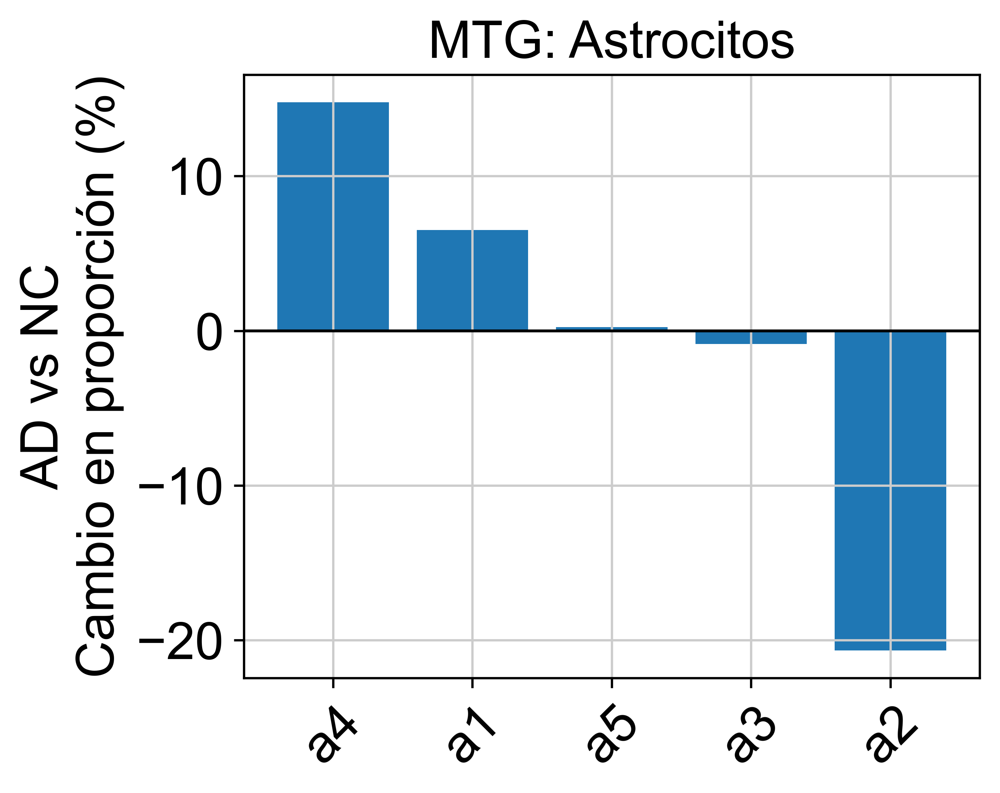

In [142]:
import matplotlib.pyplot as plt
ct_sorted = ct.sort_values("delta", ascending=False)
fig, ax = plt.subplots(figsize=(5, 4))

x = range(len(ct_sorted))

ax.bar(x, ct_sorted["delta"])

ax.set_xticks(x)
ax.set_xticklabels(ct_sorted.index, rotation=45)

ax.axhline(0, color="black", linewidth=1)

ax.set_ylabel("AD vs NC\nCambio en proporción (%)")
ax.set_title("MTG: Astrocitos")

plt.tight_layout()
plt.show()


Correcto: Calculando firmas sobre 23131 genes.
Firma UP: 742 genes | Firma DOWN: 3421 genes


C:\Users\User\AppData\Local\Temp\ipykernel_18716\504034420.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cluster_means = df_expr.groupby(cluster_col).mean()


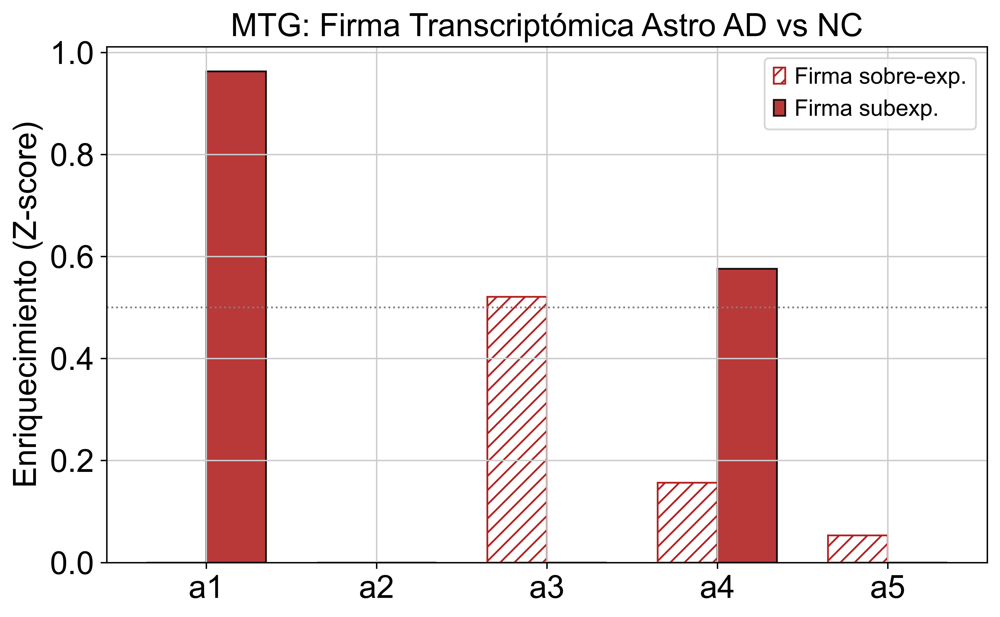

In [144]:
from scipy.stats import zscore
if adata_astro.n_vars < 5000:
    print("⚠️ PELIGRO: Parece que solo tienes los HVGs (pocos genes).")
    print("Necesitas el objeto con todos los genes (20k+) para calcular firmas reales.")
else:
    print(f"Correcto: Calculando firmas sobre {adata_astro.n_vars} genes.")

sc.tl.rank_genes_groups(
    adata_astro,
    groupby='Condition',
    method='wilcoxon',
    use_raw=True,
    pts=True,
    key_added='rank_genes_AD_vs_NC'
)

res_global = sc.get.rank_genes_groups_df(adata_astro, group='AD', key='rank_genes_AD_vs_NC')

up_signature = res_global[(res_global['pvals_adj'] < 0.05) & (res_global['logfoldchanges'] > 0.25)]['names'].tolist()
down_signature = res_global[(res_global['pvals_adj'] < 0.05) & (res_global['logfoldchanges'] < -0.25)]['names'].tolist()

print(f"Firma UP: {len(up_signature)} genes | Firma DOWN: {len(down_signature)} genes")

cluster_col = 'Acluster'

genes_of_interest = list(set(up_signature + down_signature))

genes_of_interest = [g for g in genes_of_interest if g in adata_astro.var_names]

if len(genes_of_interest) > 0:
    data_subset = adata_astro[:, genes_of_interest].X
    
    if scipy.sparse.issparse(data_subset):
        data_subset = data_subset.toarray()
        
    df_expr = pd.DataFrame(
        data_subset,
        index=adata_astro.obs_names,
        columns=genes_of_interest
    )
    df_expr[cluster_col] = adata_astro.obs[cluster_col].values

    cluster_means = df_expr.groupby(cluster_col).mean()

    z_matrix = cluster_means.apply(zscore, axis=0).fillna(0)

    enrichment_scores = pd.DataFrame(index=cluster_means.index)
    
    valid_up = [g for g in up_signature if g in z_matrix.columns]
    valid_down = [g for g in down_signature if g in z_matrix.columns]

    enrichment_scores['Firma sobreexp.'] = z_matrix[valid_up].mean(axis=1)
    enrichment_scores['Firma subexp.'] = z_matrix[valid_down].mean(axis=1)* -1

    fig, ax = plt.subplots(figsize=(8, 5))
    x = np.arange(len(enrichment_scores))
    width = 0.35

    up_values = enrichment_scores['Firma sobreexp.'].clip(lower=0)
    down_values = enrichment_scores['Firma subexp.'].clip(lower=0)

    ax.bar(x - width/2, up_values, width, label='Firma sobre-exp.', color='white', edgecolor='firebrick', hatch='///')
    ax.bar(x + width/2, down_values, width, label='Firma subexp.', color='firebrick', edgecolor='black', alpha=0.9)

    ax.axhline(y=0.5, color='gray', linestyle=':', linewidth=1)
    ax.set_ylabel('Enriquecimiento (Z-score)')
    ax.set_xticks(x)
    ax.set_xticklabels(enrichment_scores.index)
    ax.legend()
    ax.set_title('MTG: Firma Transcriptómica Astro AD vs NC')
    
    plt.tight_layout()
    plt.show()

else:
    print("Error: No se encontraron genes de la firma en el objeto. Revisa si adata_oligo tiene los genes correctos.")

In [146]:
cluster_map = {
    'a1': 'Downregulated',
    'a2': 'Stable',
    'a3': 'Upregulated',
    'a4': 'Downregulated',
    'a5': 'Stable',
    'a6': 'Stable' ,
    'a7': 'Stable',
}
adata_astro.obs['subpop_status'] = adata_astro.obs['Acluster'].map(cluster_map)
adata_astro.obs['subpop_status'] = adata_astro.obs['subpop_status'].fillna('Other')
print(adata_astro.obs['subpop_status'].value_counts())

sc.tl.rank_genes_groups(adata_astro, groupby='subpop_status', method='wilcoxon', pts=True, use_raw=True)
dedf = sc.get.rank_genes_groups_df(adata_astro, group='Downregulated')
genes_significativos = dedf[
    (dedf['pvals_adj'] < 0.05) & 
    (dedf['logfoldchanges'] > 0.25)
].sort_values('logfoldchanges', ascending=False)

print(f"Genes encontrados: {len(genes_significativos)}")

subpop_status
Downregulated    2431
Stable           1733
Upregulated      1112
Name: count, dtype: int64
Genes encontrados: 199


In [ ]:
print(genes_significativos[['names', 'logfoldchanges', 'pvals_adj']].head(10))

lista_para_GO = genes_significativos['names'].tolist()

print(f"Tienes {len(lista_para_GO)} genes para analizar.")
print("Copia estos genes:")
print('\n'.join(lista_para_GO))

          names  logfoldchanges      pvals_adj
335  AL139246.5        1.752220   5.544258e-02
185        HES5        1.743634   1.406371e-11
283  AL591686.2        1.541846   1.264021e-03
208  AC010099.4        1.057266   8.991697e-09
85      SLC14A1        1.019989   7.029436e-31
21    LINC00499        0.998932   6.286514e-71
4         FGFR3        0.962158  3.829409e-111
9        CAMK2G        0.941399   1.447294e-92
17         LGI1        0.894578   1.031802e-74
109        MRAS        0.884524   2.470536e-22
Tienes 450 genes para analizar.
Copia estos genes:
AL139246.5
HES5
AL591686.2
AC010099.4
SLC14A1
LINC00499
FGFR3
CAMK2G
LGI1
MRAS
DNAH7
SLC6A1-AS1
CDH20
HIF3A
MMD2
ACSS1
C1orf61
NAT8L
FTH1
PTCH1
HHIPL1
NPL
SPON1
COL5A3
SFXN5
GPM6A
EYA2
CABLES1
TTYH1
HEPACAM
NKAIN3
KCNN3
TPD52L1
GRM3
NCAN
NWD1
VAV3
GRAMD2B
PHF21B
SLC1A4
SLC25A18
ZNF98
MLC1
EPHX1
PDGFRB
MT3
PAPLN
AC002429.2
APCDD1
PLXNB1
SNTA1
IQCA1
FLRT2
NTRK2
ARHGEF4
MCC
RNF219-AS1
SOX2
TPCN1
SLC39A12
ETNPPL
NHSL1
DDIT4
LRRC8A
E

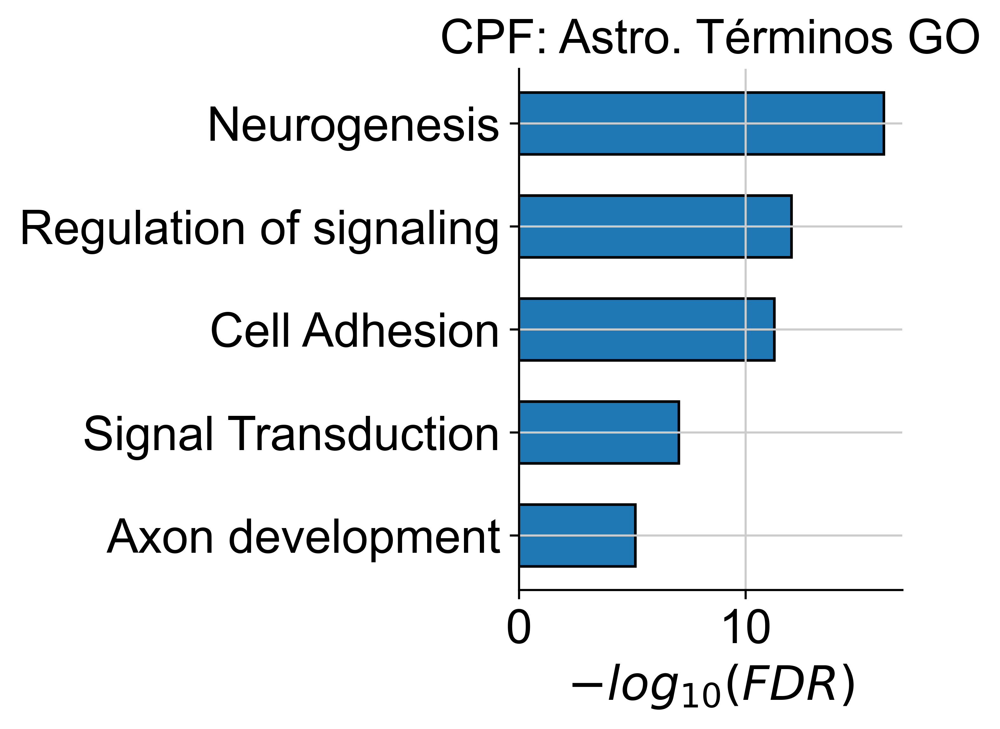

In [147]:
data = {
    'Term': [
            'Neurogenesis',
            'Regulation of signaling',
            'Axon development',
            'Signal Transduction',
            'Cell Adhesion'

    ],
    'FDR': [7.64E-17,9.14E-13,7.22E-06,8.60E-08,5.24E-12]
}
df = pd.DataFrame(data)
df['log10_FDR'] = -np.log10(df['FDR'])
df = df.sort_values('log10_FDR', ascending=True)
fig, ax = plt.subplots(figsize=(5, 4))
bars = ax.barh(df['Term'], df['log10_FDR'], edgecolor='black', height=0.6)
ax.set_xlabel(r'$-log_{10}(FDR)$')
ax.set_title('CPF: Astro. Términos GO')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
plt.tight_layout()
plt.show()

Calculando genes diferenciales...
Genes UP encontrados: 199
Genes DOWN encontrados: 7369

--- RESULTADOS HALLMARK (DOWN) ---
                        Term  Adjusted P-value  \
0  Oxidative Phosphorylation      6.023849e-20   
1          Protein Secretion      2.269742e-14   
2             Myc Targets V1      7.362656e-13   
3  Unfolded Protein Response      2.294505e-08   
4           mTORC1 Signaling      1.179213e-06   
5            Mitotic Spindle      1.306915e-05   
6               Adipogenesis      1.524920e-05   
7            heme Metabolism      2.621000e-05   
8          Androgen Response      7.364826e-05   
9   PI3K/AKT/mTOR  Signaling      8.926444e-05   

                                               Genes  
0  ISCA1;MTRR;PHB2;MPC1;PMPCA;ATP6V1E1;ACAA1;PDHX...  
1  ARF1;CLTC;SNAP23;CLTA;RAB22A;RPS6KA3;GOLGA4;SC...  
2  EIF4A1;HNRNPU;HNRNPR;PWP1;PHB2;UBE2L3;PSMD7;TR...  
3  EIF4A2;ERO1A;EIF4A1;FKBP14;HERPUD1;SERP1;KHSRP...  
4  ERO1A;TFRC;PITPNB;CCNF;UBE2D3;PLOD2;TM7SF2;TBK

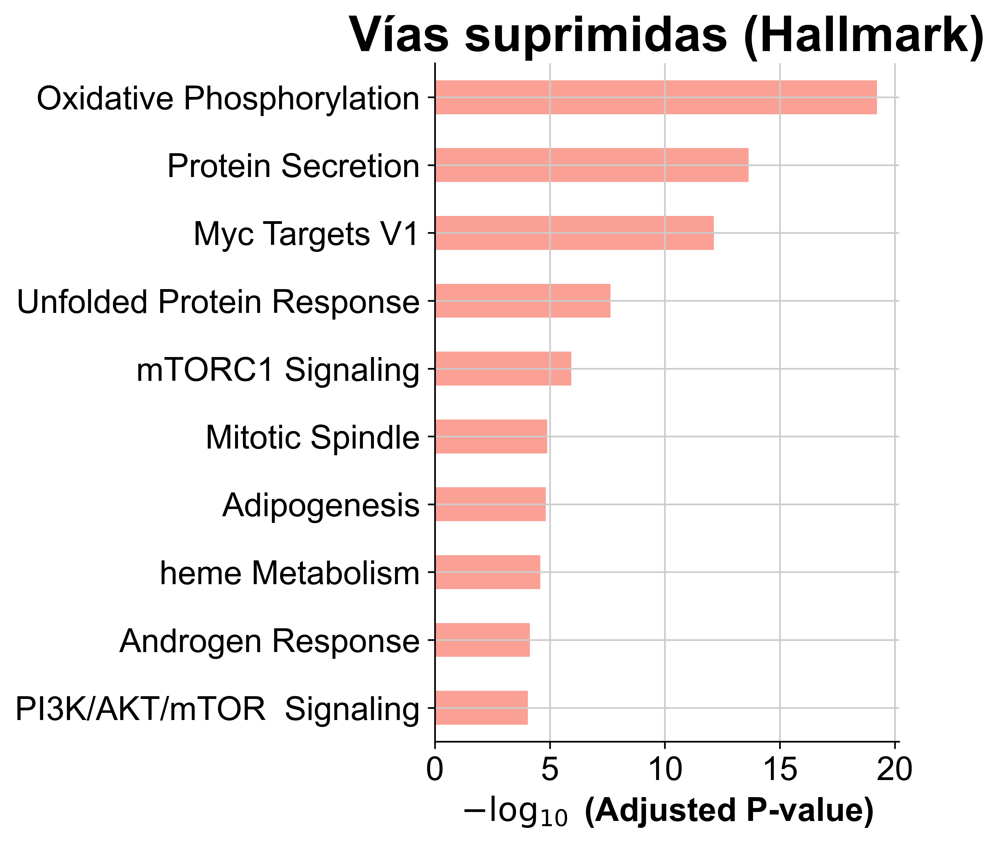


--- RESULTADOS HALLMARK (UP) ---
                                Term  Adjusted P-value  \
0                         Myogenesis          0.000030   
1                            Hypoxia          0.036609   
2                    Apical Junction          0.036609   
3  Epithelial Mesenchymal Transition          0.036609   
4            Estrogen Response Early          0.112119   
5                    Notch Signaling          0.247835   
6           PI3K/AKT/mTOR  Signaling          0.396304   
7                 TGF-beta Signaling          0.396304   
8                       Adipogenesis          0.396304   
9             Estrogen Response Late          0.396304   

                                               Genes  
0  CKMT2;ABLIM1;MRAS;NOTCH1;PPP1R3C;ITGB4;APLNR;I...  
1            SELENBP1;PPP1R3C;NCAN;RORA;GPC4;CP;EGFR  
2          CDH4;VCAN;ITGB4;MAP3K20;CNTN1;INPPL1;EGFR  
3                GJA1;VCAN;PRRX1;NTM;TNC;CRLF1;FSTL3  
4            GJA1;ABLIM1;PDLIM3;WWC1;RPS6KA2;RHOBTB3

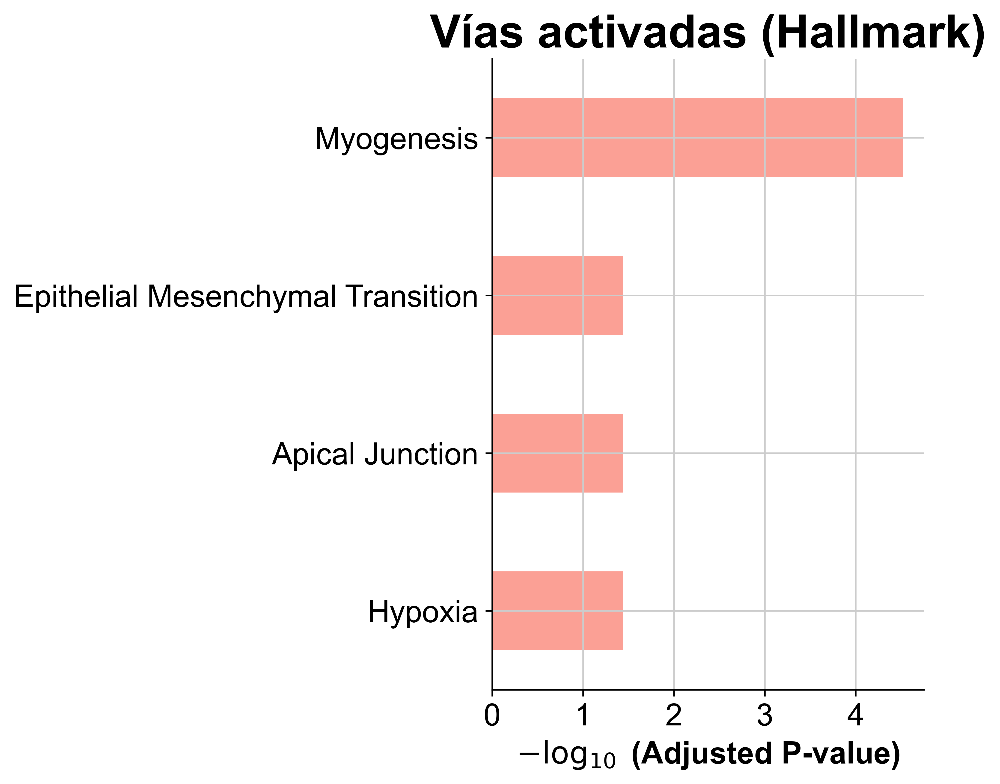

In [ ]:
import scanpy as sc
import gseapy as gp
import matplotlib.pyplot as plt

cluster_map = {
    'a1': 'Downregulated',
    'a2': 'Stable',
    'a3': 'Upregulated',
    'a4': 'Downregulated',
    'a5': 'Stable',
    'a6': 'Stable' ,
    'a7': 'Stable',
}
adata_astro.obs['analysis_group'] = adata_astro.obs['Acluster'].map(cluster_map).fillna('Reference')

print("Calculando genes diferenciales...")
sc.tl.rank_genes_groups(adata_astro, groupby='subpop_status', method='wilcoxon', pts=True, use_raw=True, n_genes=None)

dedf = sc.get.rank_genes_groups_df(adata_astro, group='Downregulated')


genes_up = dedf[ (dedf['pvals_adj'] < 0.05) & (dedf['logfoldchanges'] > 0.25) ]['names'].tolist()
genes_down = dedf[ (dedf['pvals_adj'] < 0.05) & (dedf['logfoldchanges'] < -0.25) ]['names'].tolist()

print(f"Genes UP encontrados: {len(genes_up)}")
print(f"Genes DOWN encontrados: {len(genes_down)}")

if len(genes_down) > 5:
    enr_down = gp.enrichr(gene_list=genes_down,
                          gene_sets='MSigDB_Hallmark_2020',
                          organism='human', 
                          cutoff=0.05)
    
    if not enr_down.results.empty:
        print("\n--- RESULTADOS HALLMARK (DOWN) ---")
        print(enr_down.results[['Term', 'Adjusted P-value', 'Genes']].head(10))
        
        from gseapy import barplot
        ax = barplot(enr_down.res2d, title='Vías suprimidas (Hallmark)', cutoff=0.05)
        plt.show()
    else:
        print("No se encontraron vías significativas en DOWN.")
else:
    print("No hay suficientes genes DOWN para analizar.")

if len(genes_up) > 5:
    enr_up = gp.enrichr(gene_list=genes_up,
                        gene_sets='MSigDB_Hallmark_2020',
                        organism='human', 
                        cutoff=0.05)
    
    if not enr_up.results.empty:
        print("\n--- RESULTADOS HALLMARK (UP) ---")
        print(enr_up.results[['Term', 'Adjusted P-value', 'Genes']].head(10))
        
        ax = barplot(enr_up.res2d, title='Vías activadas (Hallmark)', cutoff=0.05)
        plt.show()

In [163]:
enr_down.results

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,MSigDB_Hallmark_2020,Oxidative Phosphorylation,140/200,1.204770e-21,6.023849e-20,0,0,4.057592,195.446090,ISCA1;MTRR;PHB2;MPC1;PMPCA;ATP6V1E1;ACAA1;PDHX...
1,MSigDB_Hallmark_2020,Protein Secretion,74/96,9.078967e-16,2.269742e-14,0,0,5.813858,201.365288,ARF1;CLTC;SNAP23;CLTA;RAB22A;RPS6KA3;GOLGA4;SC...
2,MSigDB_Hallmark_2020,Myc Targets V1,126/200,4.417594e-14,7.362656e-13,0,0,2.951931,90.773645,EIF4A1;HNRNPU;HNRNPR;PWP1;PHB2;UBE2L3;PSMD7;TR...
3,MSigDB_Hallmark_2020,Unfolded Protein Response,73/113,1.835604e-09,2.294505e-08,0,0,3.149476,63.354514,EIF4A2;ERO1A;EIF4A1;FKBP14;HERPUD1;SERP1;KHSRP...
4,MSigDB_Hallmark_2020,mTORC1 Signaling,110/200,1.179213e-07,1.179213e-06,0,0,2.111570,33.686406,ERO1A;TFRC;PITPNB;CCNF;UBE2D3;PLOD2;TM7SF2;TBK...
5,MSigDB_Hallmark_2020,Mitotic Spindle,106/199,1.568298e-06,1.306915e-05,0,0,1.967592,26.297895,TRIO;SMC3;PREX1;PPP4R2;KIF5B;ARHGDIA;CDC27;ARF...
6,MSigDB_Hallmark_2020,Adipogenesis,106/200,2.134888e-06,1.524920e-05,0,0,1.946505,25.415708,SCARB1;MTCH2;PHLDB1;ARAF;GHITM;SCP2;PIM3;HADH;...
7,MSigDB_Hallmark_2020,heme Metabolism,105/200,4.193599e-06,2.621000e-05,0,0,1.907431,23.617718,ISCA1;NARF;TFRC;NR3C1;BACH1;NUDT4;CCDC28A;BSG;...
8,MSigDB_Hallmark_2020,Androgen Response,58/100,1.325669e-05,7.364826e-05,0,0,2.377898,26.706188,SRP19;NGLY1;PTPN21;DBI;CDC14B;AKAP12;RPS6KA3;H...
9,MSigDB_Hallmark_2020,PI3K/AKT/mTOR Signaling,60/105,1.785289e-05,8.926444e-05,0,0,2.295982,25.102765,ATF1;GSK3B;CDKN1A;ARF1;UBE2D3;CLTC;PTEN;PRKAG1...


In [19]:
subset

AnnData object with n_obs × n_vars = 5276 × 3000
    obs: 'Patient', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'pct_counts_mt', 'pct_counts_ribo', 'pct_counts_hb', 'outlier', 'mt_outlier', 'doublet', 'doublet_score', 'sample', '_scvi_batch', '_scvi_labels', 'overcluster', 'cell_type', 'Condition'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'hvg', '_scvi_uuid', '_scvi_manager_uuid', 'neighbors', 'overcluster', 'log1p', 'umap', 'overcluster_colors', 'Condition_colors', 'cell_type_colors'
    obsm: '_scvi_extra_categorical_covs', '_scvi_extra_continuous_covs', 'X_scVI', 'X_umap'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

Entrenando con 3693 células. Testeando con 1583 células.

--- REPORTE DE CLASIFICACIÓN ---
              precision    recall  f1-score   support

          NC       0.99      0.99      0.99      1137
          AD       0.98      0.96      0.97       446

    accuracy                           0.98      1583
   macro avg       0.98      0.98      0.98      1583
weighted avg       0.98      0.98      0.98      1583



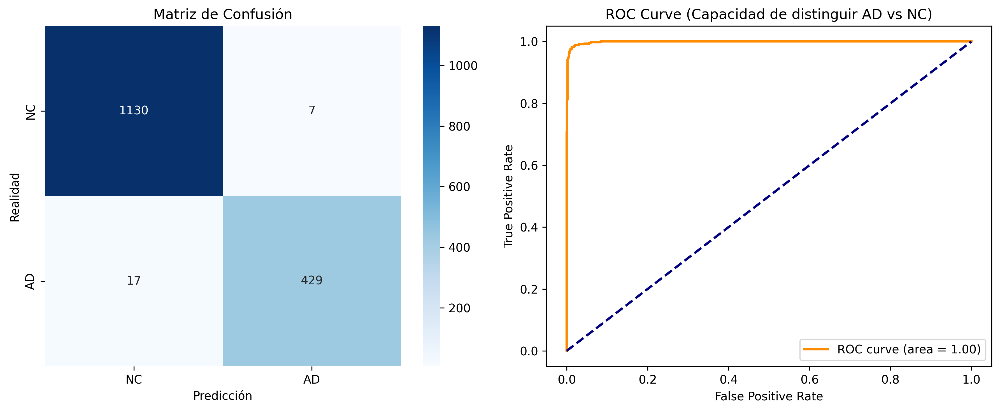


--- TOP 20 GENES PREDICTORES (Machine Learning) ---
            Gene  Coefficient
19534   SLC39A11     0.466309
8892        GRM3    -0.338739
13710      LRMDA     0.281001
12516       FTH1    -0.231311
16534   SLC25A29     0.227056
1314     PDE4DIP     0.218183
12347       CD44    -0.208252
324          ID3    -0.207456
19780    COLEC12     0.198210
8462        MMD2    -0.197469
3491       RFTN2     0.195515
1994       ESRRG    -0.191039
11711        TNC    -0.177567
13431       ABI1    -0.169402
16247       GPHN    -0.160530
5068        BCL6     0.148998
21058    ANGPTL4     0.141243
11431   FAM189A2    -0.139053
13875      HPSE2    -0.128830
16028  LINC00609    -0.128135


C:\Users\User\AppData\Local\Temp\ipykernel_20900\2895013804.py:82: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=top_genes, x='Coefficient', y='Gene', palette='vlag')


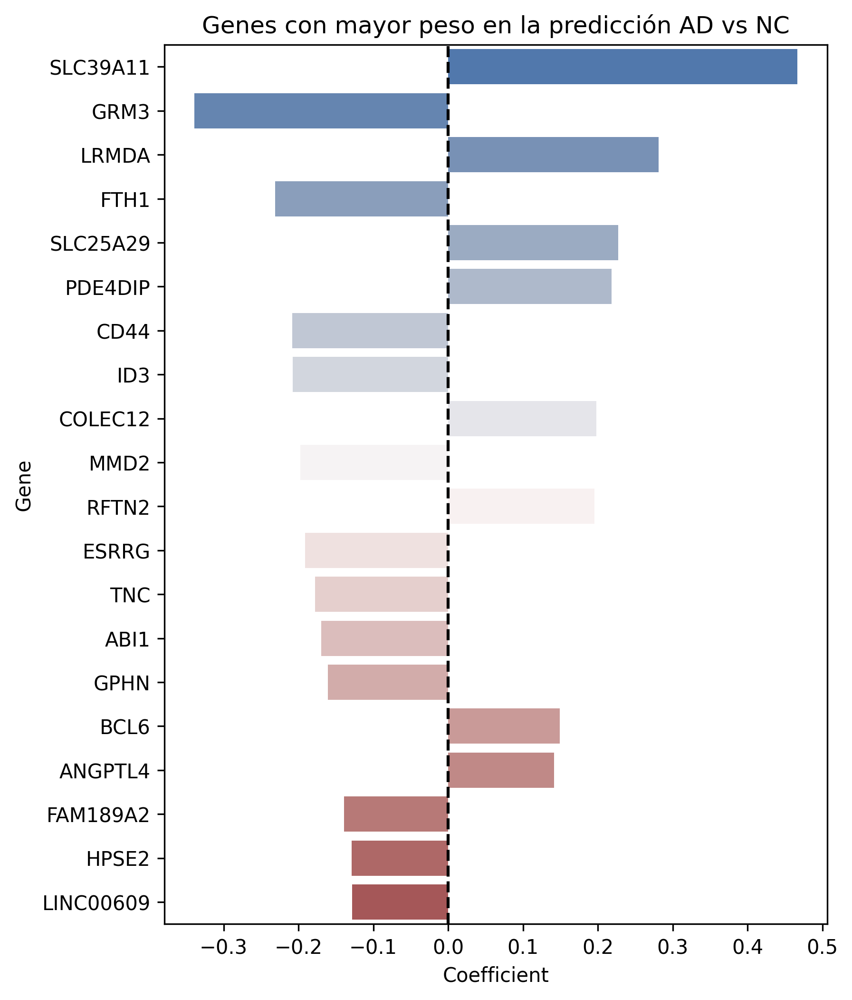

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, roc_curve, auc, confusion_matrix
from sklearn.preprocessing import StandardScaler

astro_barcodes = adata.obs[adata.obs['cell_type'] == 'Astro'].index
adata_full = adata.raw.to_adata()
adata_astro = adata_full[astro_barcodes].copy()
adata_astro.obs = adata.obs.loc[astro_barcodes].copy()


#subset = subset[:, subset.var['highly_variable']] 

X = adata_astro.X
if hasattr(X, "toarray"):
    X = X.toarray()

# Etiquetas: 1 para AD, 0 para NC
y = adata_astro.obs['Condition'].map({'AD': 1, 'NC': 0, 'HC': 0}).values

# 2. SPLIT TRAIN-TEST (Dividimos las células: 70% para aprender, 30% para examen)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)

print(f"Entrenando con {X_train.shape[0]} células. Testeando con {X_test.shape[0]} células.")

# 3. ENTRENAR MODELO (Regresión Logística con L1 para selección de genes)
# C aumenta la regularización. Solver 'liblinear' va bien para datasets pequeños/medianos.
model = LogisticRegression(penalty='l1', C=0.1, solver='liblinear', random_state=42, max_iter=1000)
model.fit(X_train, y_train)

# 4. EVALUAR
y_pred = model.predict(X_test)
y_prob = model.predict_proba(X_test)[:, 1] # Probabilidad de ser AD

print("\n--- REPORTE DE CLASIFICACIÓN ---")
print(classification_report(y_test, y_pred, target_names=['NC', 'AD']))

# 5. GRÁFICOS (Curva ROC y Matriz de Confusión)
fig, ax = plt.subplots(1, 2, figsize=(12, 5))

# Matriz de confusión
cm = confusion_matrix(y_test, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', ax=ax[0])
ax[0].set_title('Matriz de Confusión')
ax[0].set_xlabel('Predicción')
ax[0].set_ylabel('Realidad')
ax[0].set_xticklabels(['NC', 'AD'])
ax[0].set_yticklabels(['NC', 'AD'])

# Curva ROC
fpr, tpr, _ = roc_curve(y_test, y_prob)
roc_auc = auc(fpr, tpr)
ax[1].plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
ax[1].plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
ax[1].set_xlabel('False Positive Rate')
ax[1].set_ylabel('True Positive Rate')
ax[1].set_title('ROC Curve (Capacidad de distinguir AD vs NC)')
ax[1].legend(loc="lower right")

plt.tight_layout()
plt.show()

coefs = pd.DataFrame({
    'Gene': adata_astro.var_names,
    'Coefficient': model.coef_[0]
})
# Ordenamos por importancia absoluta
coefs['Abs_Coeff'] = coefs['Coefficient'].abs()
top_genes = coefs.sort_values('Abs_Coeff', ascending=False).head(20)

print("\n--- TOP 20 GENES PREDICTORES (Machine Learning) ---")
print(top_genes[['Gene', 'Coefficient']])

# Graficar los coeficientes top
plt.figure(figsize=(6, 8))
sns.barplot(data=top_genes, x='Coefficient', y='Gene', palette='vlag')
plt.title('Genes con mayor peso en la predicción AD vs NC')
plt.axvline(0, color='black', linestyle='--')
plt.show()

In [21]:
adata_astro

AnnData object with n_obs × n_vars = 5276 × 23131
    obs: 'Patient', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'pct_counts_mt', 'pct_counts_ribo', 'pct_counts_hb', 'outlier', 'mt_outlier', 'doublet', 'doublet_score', 'sample', '_scvi_batch', '_scvi_labels', 'overcluster', 'cell_type', 'Condition'
    var: 'n_cells'
    uns: 'hvg', '_scvi_uuid', '_scvi_manager_uuid', 'neighbors', 'overcluster', 'log1p', 'umap', 'overcluster_colors', 'Condition_colors', 'cell_type_colors'
    obsm: '_scvi_extra_categorical_covs', '_scvi_extra_continuous_covs', 'X_scVI', 'X_umap'
    obsp: 'distances', 'connectivities'

ML Predictive Model

Entrenando con 6561 células. Testeando con 2813 células.

--- REPORTE DE CLASIFICACIÓN ---
              precision    recall  f1-score   support

          NC       0.97      0.98      0.98       912
          AD       0.99      0.99      0.99      1901

    accuracy                           0.98      2813
   macro avg       0.98      0.98      0.98      2813
weighted avg       0.98      0.98      0.98      2813



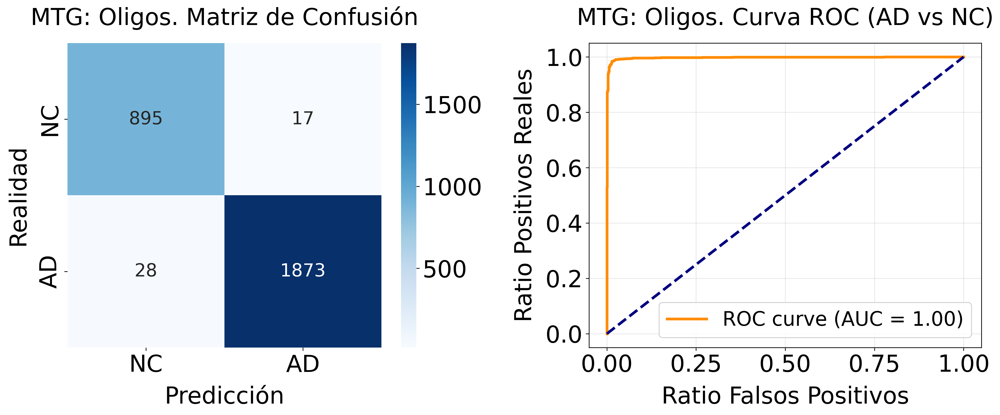


--- TOP 20 GENES PREDICTORES ---
           Gene  Coefficient
1104      FKBP5     1.268059
2737      PTPRM     1.118883
2744    LDLRAD4    -0.844182
1636     NECAB1    -0.798087
2635      PLCG2     0.667185
2599        MT3     0.601460
2787       BCL2     0.508902
1921     ZBTB16     0.498665
2713      ABCA6     0.410522
1249  PACRG-AS3     0.368725
2000     JMJD1C    -0.360762
345      CTNNA2     0.358261
2538      MEF2A    -0.337276
1766      FANCC     0.334734
2256      PDS5B     0.334689
2239    ZDHHC20     0.333478
1653      ZFPM2     0.330100
573     ST3GAL6     0.321809
1350       SEM1     0.319194
1407        PTN     0.309207


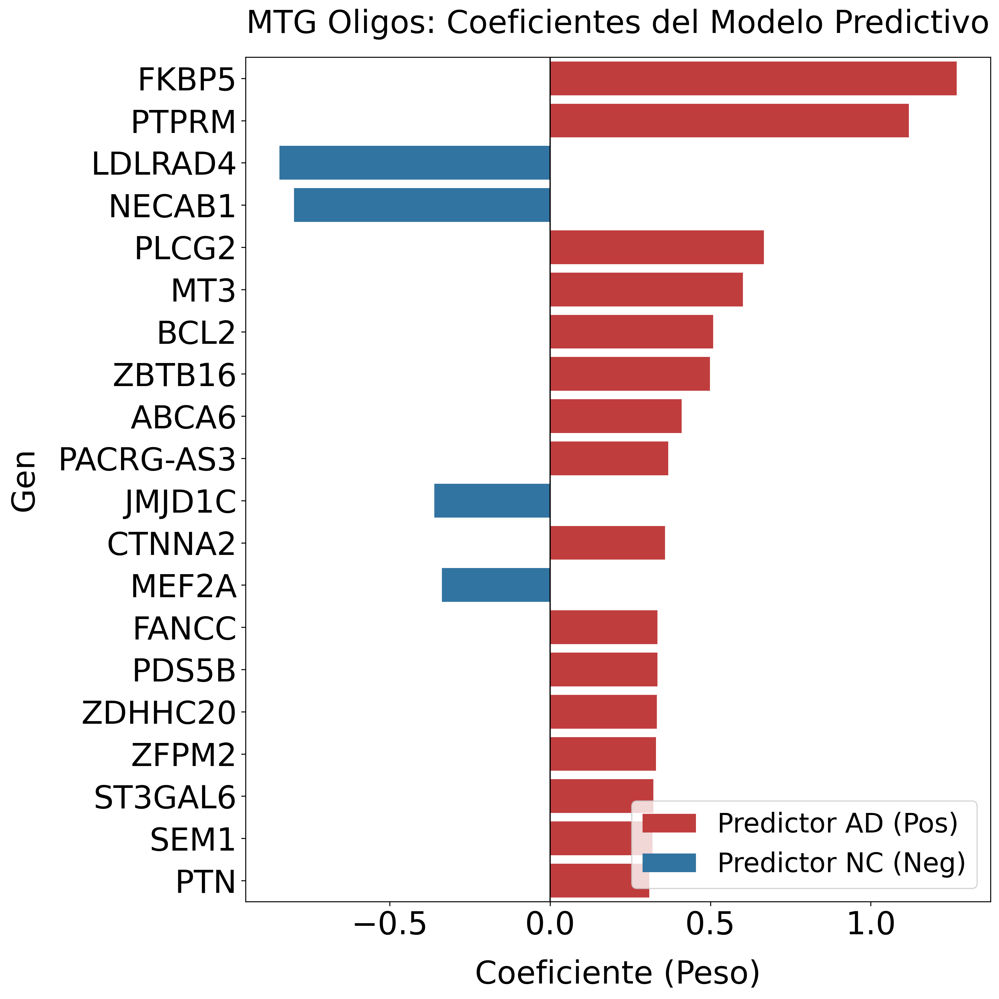

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, roc_curve, auc, confusion_matrix
from sklearn.preprocessing import StandardScaler

plt.rcParams.update({
    'font.size': 26,
    'axes.titlesize': 26,
    'axes.labelsize': 26,
    'xtick.labelsize': 26,
    'ytick.labelsize': 26,
    'legend.fontsize': 22,
    'figure.titlesize': 26
})

oligo_barcodes = adata.obs[adata.obs['cell_type'] == 'Oligo'].index
adata_full = adata.raw.to_adata()
adata_oligo = adata_full[oligo_barcodes].copy()
adata_oligo.obs = adata.obs.loc[oligo_barcodes].copy()

sc.pp.highly_variable_genes(
    adata_oligo, 
    flavor="seurat_v3", 
    n_top_genes=3000, 
    subset=False
)

adata_oligo = adata_oligo[:, adata_oligo.var['highly_variable']] 

X = adata_oligo.X
if hasattr(X, "toarray"):
    X = X.toarray()

y = adata_oligo.obs['Condition'].map({'AD': 1, 'NC': 0, 'HC': 0}).values

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)

print(f"Entrenando con {X_train.shape[0]} células. Testeando con {X_test.shape[0]} células.")

model = LogisticRegression(penalty='l1', C=0.1, solver='liblinear', random_state=42, max_iter=1000)
model.fit(X_train, y_train)

y_pred = model.predict(X_test)
y_prob = model.predict_proba(X_test)[:, 1]

print("\n--- REPORTE DE CLASIFICACIÓN ---")
print(classification_report(y_test, y_pred, target_names=['NC', 'AD']))

fig, ax = plt.subplots(1, 2, figsize=(16, 7))

cm = confusion_matrix(y_test, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', ax=ax[0], annot_kws={"size": 20})
ax[0].set_title('MTG: Oligos. Matriz de Confusión', pad=20)
ax[0].set_xlabel('Predicción', labelpad=10)
ax[0].set_ylabel('Realidad', labelpad=10)
ax[0].set_xticklabels(['NC', 'AD'])
ax[0].set_yticklabels(['NC', 'AD'])

fpr, tpr, _ = roc_curve(y_test, y_prob)
roc_auc = auc(fpr, tpr)
ax[1].plot(fpr, tpr, color='darkorange', lw=3, label=f'ROC curve (AUC = {roc_auc:.2f})')
ax[1].plot([0, 1], [0, 1], color='navy', lw=3, linestyle='--')
ax[1].set_xlabel('Ratio Falsos Positivos', labelpad=10)
ax[1].set_ylabel('Ratio Positivos Reales', labelpad=10)
ax[1].set_title('MTG: Oligos. Curva ROC (AD vs NC)', pad=20)
ax[1].legend(loc="lower right", frameon=True, fancybox=True, framealpha=0.9)
ax[1].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

coefs = pd.DataFrame({
    'Gene': adata_oligo.var_names,
    'Coefficient': model.coef_[0]
})
coefs['Abs_Coeff'] = coefs['Coefficient'].abs()
top_genes = coefs.sort_values('Abs_Coeff', ascending=False).head(20)

top_genes['Association'] = np.where(top_genes['Coefficient'] > 0, 'Predictor AD (Pos)', 'Predictor NC (Neg)')

print("\n--- TOP 20 GENES PREDICTORES ---")
print(top_genes[['Gene', 'Coefficient']])

plt.figure(figsize=(12, 12)) 

sns.barplot(
    data=top_genes, 
    x='Coefficient', 
    y='Gene', 
    hue='Association',
    palette={'Predictor AD (Pos)': '#d62728', 'Predictor NC (Neg)': '#1f77b4'},
    dodge=False
)

plt.title('MTG Oligos: Coeficientes del Modelo Predictivo', pad=20)
plt.xlabel('Coeficiente (Peso)', labelpad=15)
plt.ylabel('Gen', labelpad=15)
plt.axvline(0, color='black', linestyle='-', linewidth=1)
plt.legend(loc='lower right')


plt.tight_layout()
plt.show()

Entrenando con 3693 células. Testeando con 1583 células.

--- REPORTE DE CLASIFICACIÓN ---
              precision    recall  f1-score   support

          NC       0.99      0.99      0.99      1137
          AD       0.97      0.96      0.97       446

    accuracy                           0.98      1583
   macro avg       0.98      0.98      0.98      1583
weighted avg       0.98      0.98      0.98      1583



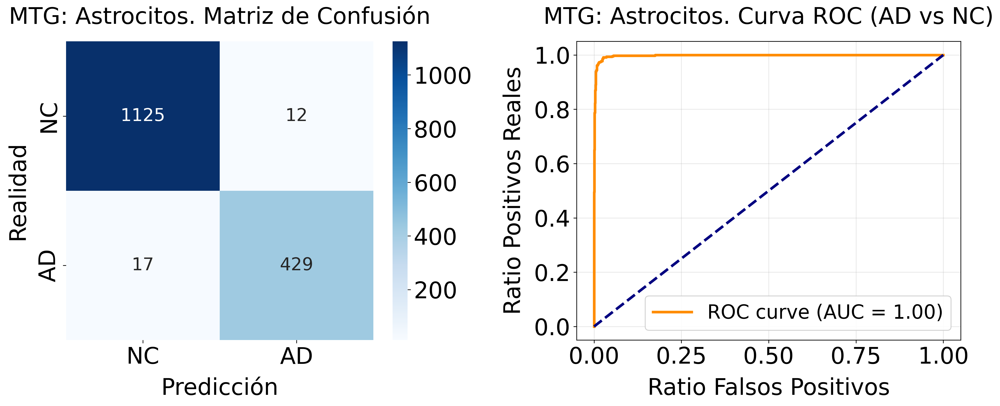


--- TOP 20 GENES PREDICTORES ---
            Gene  Coefficient
2569      BAIAP3     0.657845
2030       LRMDA     0.505272
1576       DOCK5     0.463386
1353        GRM3    -0.404693
1125     PHACTR1    -0.327200
1628       GDAP1     0.311839
2791      NEDD4L     0.306231
2302       ENOX1    -0.292792
27           ID3    -0.290940
1601     SLC20A2     0.269816
793       LIMCH1    -0.265098
2738     COLEC12     0.263893
1880        CD44    -0.261877
2414     ZFP36L1     0.239652
1258      ARID1B    -0.215794
2997      MT-ND4    -0.212416
1809         TNC    -0.203980
1756     ALDH1A1    -0.202678
2870     ANGPTL4     0.193053
772   AC098829.1    -0.180435


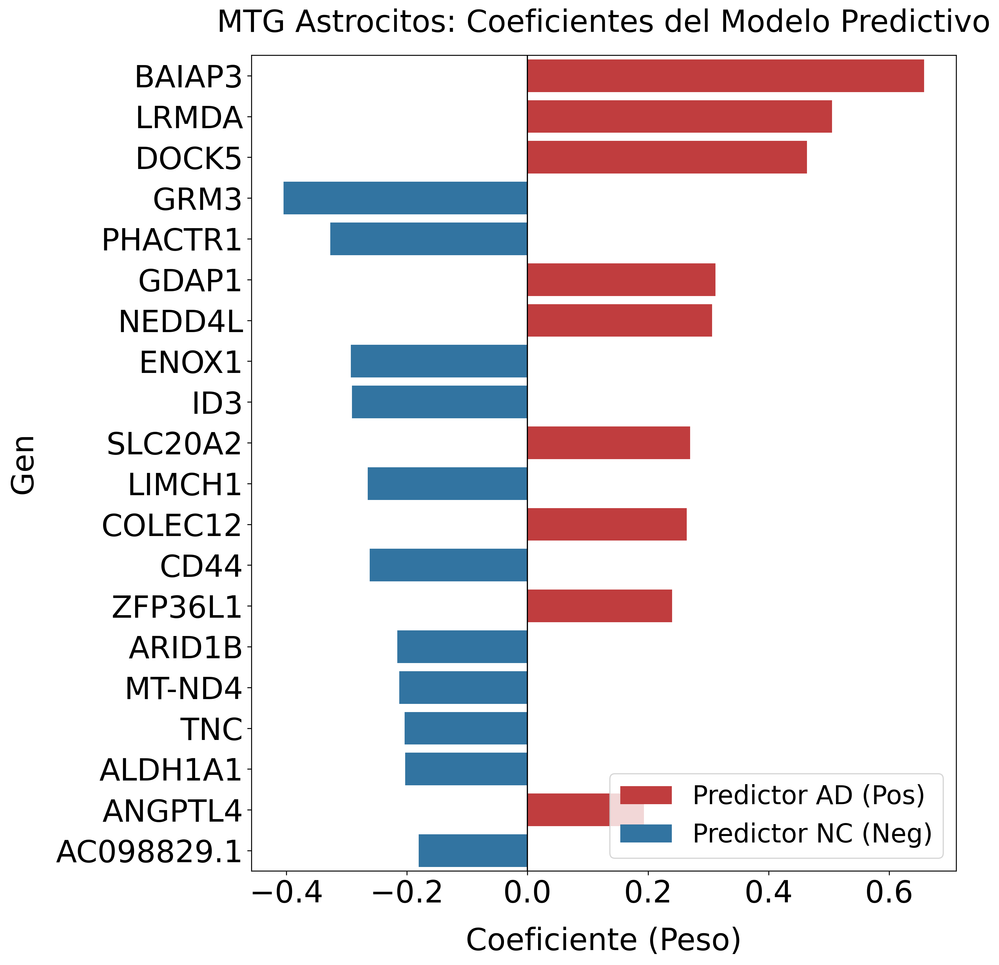

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, roc_curve, auc, confusion_matrix

plt.rcParams.update({
    'font.size': 26,
    'axes.titlesize': 26,
    'axes.labelsize': 26,
    'xtick.labelsize': 26,
    'ytick.labelsize': 26,
    'legend.fontsize': 22,
    'figure.titlesize': 26
})

astro_barcodes = adata.obs[adata.obs['cell_type'] == 'Astro'].index
adata_full = adata.raw.to_adata()
adata_astro = adata_full[astro_barcodes].copy()
adata_astro.obs = adata.obs.loc[astro_barcodes].copy()

sc.pp.highly_variable_genes(
    adata_astro, 
    flavor="seurat_v3", 
    n_top_genes=3000, 
    subset=False
)

adata_astro = adata_astro[:, adata_astro.var['highly_variable']] 

X = adata_astro.X
if hasattr(X, "toarray"):
    X = X.toarray()

y = adata_astro.obs['Condition'].map({'AD': 1, 'NC': 0, 'HC': 0}).values

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)

print(f"Entrenando con {X_train.shape[0]} células. Testeando con {X_test.shape[0]} células.")

model = LogisticRegression(penalty='l1', C=0.1, solver='liblinear', random_state=42, max_iter=1000)
model.fit(X_train, y_train)

y_pred = model.predict(X_test)
y_prob = model.predict_proba(X_test)[:, 1]

print("\n--- REPORTE DE CLASIFICACIÓN ---")
print(classification_report(y_test, y_pred, target_names=['NC', 'AD']))

fig, ax = plt.subplots(1, 2, figsize=(16, 7))


cm = confusion_matrix(y_test, y_pred)

sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', ax=ax[0], annot_kws={"size": 20})
ax[0].set_title('MTG: Astrocitos. Matriz de Confusión', pad=20)
ax[0].set_xlabel('Predicción', labelpad=10)
ax[0].set_ylabel('Realidad', labelpad=10)
ax[0].set_xticklabels(['NC', 'AD'])
ax[0].set_yticklabels(['NC', 'AD'])


fpr, tpr, _ = roc_curve(y_test, y_prob)
roc_auc = auc(fpr, tpr)
ax[1].plot(fpr, tpr, color='darkorange', lw=3, label=f'ROC curve (AUC = {roc_auc:.2f})')
ax[1].plot([0, 1], [0, 1], color='navy', lw=3, linestyle='--')
ax[1].set_xlabel('Ratio Falsos Positivos', labelpad=10)
ax[1].set_ylabel('Ratio Positivos Reales', labelpad=10)
ax[1].set_title('MTG: Astrocitos. Curva ROC (AD vs NC)', pad=20)
ax[1].legend(loc="lower right", frameon=True, fancybox=True, framealpha=0.9)
ax[1].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()


coefs = pd.DataFrame({
    'Gene': adata_astro.var_names,
    'Coefficient': model.coef_[0]
})
coefs['Abs_Coeff'] = coefs['Coefficient'].abs()
top_genes = coefs.sort_values('Abs_Coeff', ascending=False).head(20)

top_genes['Association'] = np.where(top_genes['Coefficient'] > 0, 'Predictor AD (Pos)', 'Predictor NC (Neg)')

print("\n--- TOP 20 GENES PREDICTORES ---")
print(top_genes[['Gene', 'Coefficient']])

plt.figure(figsize=(12, 12)) 

sns.barplot(
    data=top_genes, 
    x='Coefficient', 
    y='Gene', 
    hue='Association',
    palette={'Predictor AD (Pos)': '#d62728', 'Predictor NC (Neg)': '#1f77b4'},
    dodge=False
)

plt.title('MTG Astrocitos: Coeficientes del Modelo Predictivo', pad=20)
plt.xlabel('Coeficiente (Peso)', labelpad=15)
plt.ylabel('Gen', labelpad=15)
plt.axvline(0, color='black', linestyle='-', linewidth=1)
plt.legend(loc='lower right')


plt.tight_layout()
plt.show()